In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
sns.set_style('whitegrid')
sns.set_context('talk', font_scale=2.5)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

import warnings
warnings.filterwarnings('ignore')

output_path = '../results/simulations/2025_figures'

In [2]:
res_df = pd.read_csv('../results/20250313_big_table_bootstrap.csv', sep='\t')
print(res_df.shape)


(561600, 43)


In [3]:
res_df.head()

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp
0,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,coefficient_product,1.523545,1.470279,1.470279,0.053266,0.053266,0.104086,1.420253,1.606637,1.386472,1.550347,1.386472,1.550347,0.003102,0.096086,0.003102,0.096086,True,0.186384,True,0.163875,True,0.163875,True,0.092984,True,0.092984,1.741176e+09
1,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_noreg,1.518898,1.487598,1.444149,0.074749,0.031300,0.076701,1.416778,1.602655,1.401856,1.563469,1.355329,1.532069,0.004115,0.129807,0.001398,0.068193,True,0.185877,True,0.161613,True,0.176740,True,0.125692,True,0.066795,1.741176e+09
2,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg,1.545092,1.489956,1.441118,0.103975,0.055137,0.231434,1.426136,1.607725,1.410763,1.582901,1.376152,1.561818,-0.024622,0.135509,-0.012911,0.071225,True,0.181589,True,0.172138,True,0.185666,True,0.160131,True,0.084136,1.741176e+09
3,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_forest,1.526911,1.522203,1.496089,0.030822,0.004708,0.522162,1.426685,1.592737,1.432337,1.597024,1.420143,1.571583,-0.004881,0.058802,-0.012702,0.022168,True,0.166052,True,0.164687,True,0.151441,False,0.063683,False,0.034870,1.741176e+09
4,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg_cf,1.527076,1.517817,1.499933,0.027143,0.009259,0.476440,1.423605,1.610887,1.421778,1.580106,1.383297,1.569722,-0.031510,0.124352,-0.026873,0.059338,True,0.187282,True,0.158328,True,0.186425,True,0.155863,True,0.086211,1.741176e+09


In [4]:
res_df = res_df.assign(med_setting='prop_low_no_overlap_violation')
res_df.loc[(res_df.wt_list<=2)&(res_df.wm_list>=5), 'med_setting'] = 'prop_high_no_overlap_violation'
res_df.loc[(res_df.wt_list>=1)&(res_df.wm_list<=2), 'med_setting'] = 'prop_high_strong_overlap_violation'
all_configs = ['prop_low_no_overlap_violation',
               'prop_high_no_overlap_violation',
               'prop_high_strong_overlap_violation']



In [5]:
res_df.estimator.nunique()

26

In [6]:
nice_names_dict = \
{"coefficient_product"                   : "Coefficient product",
"mediation_g_computation_exp_forest"          : "G-computation (forest)",
"mediation_g_computation_exp_forest_cf"               : "G-computation (forest & cross-fitting)",
"mediation_g_computation_exp_noreg"                   : "G-computation (no regularization)",
"mediation_g_computation_exp_reg"                     : "G-computation (regularization)",
"mediation_g_computation_exp_reg_cf"                  : "G-computation (regularization & cross-fitting)",
"mediation_g_computation_imp_forest"          : "G-computation (forest)",
"mediation_g_computation_imp_forest_cf"               : "G-computation (forest & cross-fitting)",
"mediation_g_computation_imp_noreg"                   : "G-computation (no regularization)",
"mediation_g_computation_imp_reg"                     : "G-computation (regularization)",
"mediation_g_computation_imp_reg_cf"                  : "G-computation (regularization & cross-fitting)",
"mediation_ipw_forest"                      : "IPW (forest)",
"mediation_ipw_forest_cf"                   : "IPW (forest & cross-fitting)",
"mediation_ipw_noreg"                       : "IPW (no regularization)",
"mediation_ipw_reg"                         : "IPW (regularization)",
"mediation_ipw_reg_cf"                      : "IPW (regularization & cross-fitting)",
"mediation_multiply_robust_forest"                : "multiply robust (forest)",
"mediation_multiply_robust_forest_cf"             : "multiply robust (forest & cross-fitting)",
"mediation_multiply_robust_noreg"                 : "multiply robust (no regularization)",
"mediation_multiply_robust_reg"                   : "multiply robust (regularization)",
"mediation_multiply_robust_reg_cf"                : "multiply robust (regularization & cross-fitting)",
"mediation_DML_noreg"                   : "medDML (no regularization)",
"mediation_DML_reg"                     : "medDML (regularization)",
"mediation_DML_reg_cf"                  :  "medDML (regularization & cross-fitting)",
'mediation_DML_forest'                  : "medDML (forest)",
'mediation_DML_forest_cf'               : "medDML (forest & cross-fitting)",
'TMLE_forest'                           : 'TMLE (forest)',
 'TMLE_noreg'                           : 'TMLE (no regularization)',
 'TMLE_reg'                           : 'TMLE (regularization)',
}
res_df = res_df.assign(nice_estimator=res_df.estimator.map(nice_names_dict))


res_df = res_df.assign(forest=res_df.nice_estimator.str.contains('forest'))
res_df = res_df.assign(cross_fitting=res_df.nice_estimator.str.contains('cross-fitting'))
res_df = res_df.assign(regularization=res_df.nice_estimator.str.contains('\(regularization'))
res_df = res_df.assign(base_estimator=res_df.nice_estimator.str.split(' \(').str.get(0))

res_df = res_df[(res_df.base_estimator!='multiply robust')|(res_df.type_m=='binary')]
res_df = res_df[(~res_df.estimator.str.contains('mediation_g_computation_exp'))|(res_df.type_m=='binary')]
res_df = res_df[(~res_df.estimator.str.contains('mediation_g_computation_imp'))|(res_df.type_m!='binary')]


In [7]:
res_df = res_df.assign(total_effect_error=(res_df.total_effect-res_df.total)/res_df.total,
                       direct_effect_error=(res_df.direct_control_effect-res_df.direct_0)/res_df.direct_0,
                       indirect_effect_error=(res_df.indirect_treated_effect-res_df.indirect_1)/res_df.indirect_1)

In [8]:
res_df[res_df.type_m=='continuous'].dim_m.value_counts()
res_df = res_df.assign(configuration = "")
res_df.loc[(res_df.type_m=='binary'), 'configuration'] = 'binary - 1D M'
res_df.loc[(res_df.type_m=='continuous')&(res_df.dim_m==1), 'configuration'] = 'continuous - 1D M'
res_df.loc[(res_df.type_m=='continuous')&(res_df.dim_m==5), 'configuration'] = 'continuous - 5D M'


In [9]:
res_df = res_df.assign(setting_name = "")
res_df.loc[(res_df.m_misspec==False)&(res_df.y_misspec==False), 'setting_name'] = "linear"
res_df.loc[(res_df.m_misspec==True)&(res_df.y_misspec==False), 'setting_name'] = "misspecification M"
res_df.loc[(res_df.m_misspec==False)&(res_df.y_misspec==True), 'setting_name'] = "misspecification Y"
res_df.loc[(res_df.m_misspec==True)&(res_df.y_misspec==True), 'setting_name'] = "misspecification M & Y"
setting_order = ["linear", "misspecification M", "misspecification Y", "misspecification M & Y"]

In [10]:
res_df.estimator.value_counts()

coefficient_product                      21600
mediation_DML_noreg                      21600
mediation_ipw_reg                        21600
mediation_ipw_forest                     21600
mediation_ipw_reg_cf                     21600
mediation_ipw_forest_cf                  21600
mediation_DML_forest_cf                  21600
mediation_DML_forest                     21600
mediation_DML_reg_cf                     21600
mediation_ipw_noreg                      21600
mediation_DML_reg                        21600
mediation_g_computation_imp_reg_cf       14400
mediation_g_computation_imp_forest       14400
mediation_g_computation_imp_reg          14400
mediation_g_computation_imp_noreg        14400
mediation_g_computation_imp_forest_cf    14400
mediation_multiply_robust_forest_cf       7200
mediation_multiply_robust_reg_cf          7200
mediation_multiply_robust_reg             7200
mediation_multiply_robust_noreg           7200
mediation_g_computation_exp_forest_cf     7200
mediation_g_c

In [11]:
most_basic_estimators = ['coefficient_product', 'mediation_ipw_reg',
                         #'huber_ipw_reg_calibration_cf',
#              'huber_ipw_forest',
              'mediation_g_computation_exp_reg',
#              'g_computation_forest',
              'mediation_multiply_robust_reg',
#              'multiply_robust_forest',
              'mediation_DML_reg',
               'TMLE_reg']

most_basic_estimators = ["Coefficient product",
                         "G-computation (no regularization)",
                         "IPW (no regularization)",
                         "multiply robust (no regularization)",
                         "medDML (no regularization)"]


In [27]:
res_df.duration.sum() / 60 / 60 / 24

8.669716652043991

In [12]:
res_df_melt = pd.melt(res_df,
                      id_vars=[c for c in res_df.columns if 'error' not in c],
                     value_vars=[c for c in res_df.columns if 'error' in c],
                     value_name='relative error')
res_df_melt = res_df_melt.assign(effect_name=res_df_melt.variable.str.replace('_effect_error', ''))
res_df_melt.sample(5)

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,configuration,setting_name,variable,relative error,effect_name
1086845,169,1000,5,1,continuous,2.0,1.0,False,False,0.454545,2.200000,1.200000,1.200000,1.000000,1.000000,mediation_ipw_noreg,2.180560,1.322039,1.719850,0.460710,0.858521,0.069842,2.100766,2.241209,1.053678,1.850219,1.385666,2.265702,-0.076390,0.799337,0.314322,1.100921,True,0.140443,True,0.796541,False,0.880036,False,0.875728,True,0.786599,1.741863e+09,prop_high_strong_overlap_violation,IPW (no regularization),False,False,False,IPW,continuous - 1D M,linear,indirect_effect_error,-0.539290,indirect
109858,57,1000,5,1,binary,4.0,2.0,True,False,0.283751,1.675396,1.200000,1.200000,0.475396,0.475396,coefficient_product,1.724659,1.233714,1.233714,0.490945,0.490945,0.031709,1.648086,1.804604,1.158572,1.299656,1.158572,1.299656,0.437095,0.540127,0.437095,0.540127,True,0.156518,True,0.141084,True,0.141084,True,0.103032,True,0.103032,1.741178e+09,prop_high_strong_overlap_violation,Coefficient product,False,False,False,Coefficient product,binary - 1D M,misspecification M,total_effect_error,0.029404,total
762374,199,1000,5,1,binary,4.0,2.0,False,True,0.328806,2.165094,1.690498,1.453199,0.711895,0.474597,mediation_ipw_noreg,2.131982,1.667556,1.637538,0.494443,0.464426,0.063728,2.059413,2.203590,1.593930,1.758734,1.484432,1.791008,0.333092,0.640153,0.404041,0.517336,True,0.144178,True,0.164804,False,0.306576,False,0.307061,True,0.113295,1.741872e+09,prop_high_strong_overlap_violation,IPW (no regularization),False,False,False,IPW,binary - 1D M,misspecification Y,direct_effect_error,0.126850,direct
317447,166,1000,5,1,binary,0.5,0.5,False,False,0.024030,1.229546,1.200000,1.200000,0.029546,0.029546,mediation_DML_forest_cf,1.243748,1.209682,1.211353,0.032394,0.034066,3.112063,1.198156,1.305309,1.168492,1.287774,1.166520,1.293751,0.000722,0.055649,-0.000858,0.044774,True,0.107154,True,0.119282,True,0.127232,True,0.054927,True,0.045632,1.741182e+09,prop_low_no_overlap_violation,medDML (forest & cross-fitting),True,True,False,medDML,binary - 1D M,linear,total_effect_error,0.011550,total
611091,120,500,5,1,continuous,2.0,1.0,False,True,0.623708,3.206629,2.206629,1.206629,2.000000,1.000000,mediation_g_computation_imp_reg,3.157667,2.131548,1.210866,1.946801,1.026120,0.527864,3.048910,3.265266,1.930421,2.691780,0.787676,1.696313,1.459808,2.308403,0.526292,1.237258,True,0.216356,True,0.761359,True,0.908637,True,0.848595,True,0.710966,1.741181e+09,prop_high_strong_overlap_violation,G-computation (regularization),False,False,True,G-computation,continuous - 1D M,misspecification Y,direct_effect_error,0.003511,direct


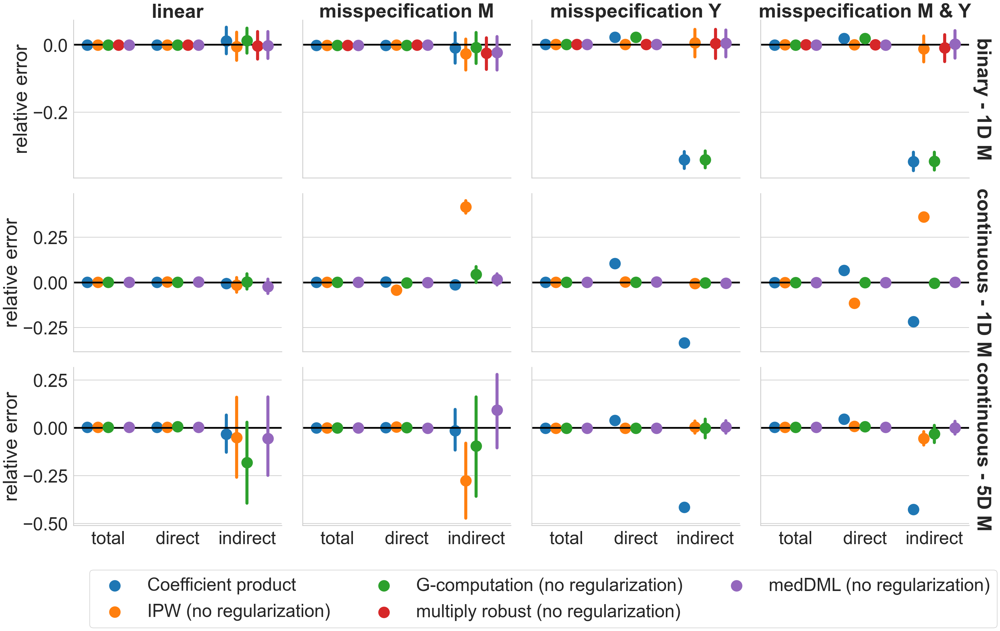

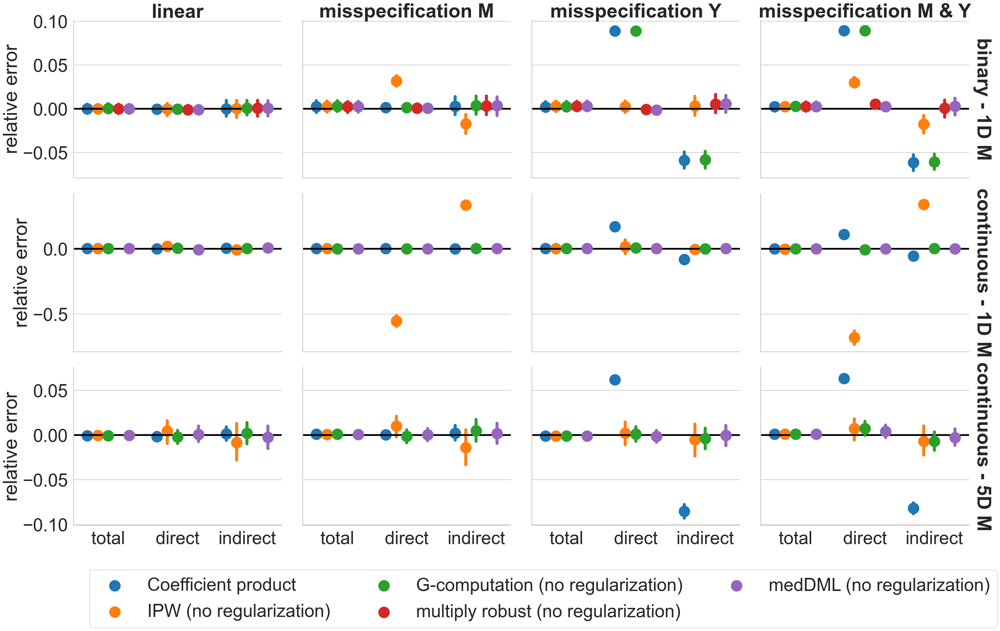

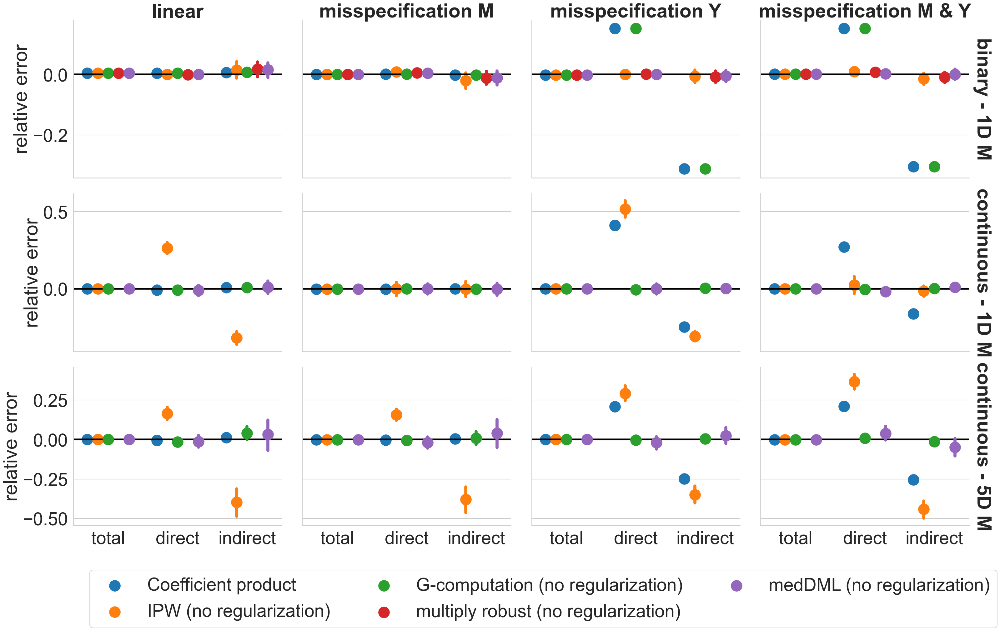

In [32]:
for conf in all_configs:
    g = sns.catplot(x="effect_name", y="relative error", hue="nice_estimator",
            col="setting_name", row='configuration',
            data=res_df_melt[(res_df_melt.med_setting==conf)&(res_df_melt.nice_estimator.isin(most_basic_estimators))&(res_df_melt.n==1000)],
            aspect=1.3, height=7,
            kind='point', sharey='row', margin_titles=True, dodge=0.6,
            capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
            facet_kws={"gridspec_kws": {"hspace":0.1}})
    for i in range(g.axes.shape[0]):
        for j in range(g.axes.shape[1]):
            true_val = 0
            g.axes[i, j].axhline(y=true_val, color="black", lw=4)
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    for ax in g.axes.ravel():
        ax.set_xlabel(ax.get_xlabel().replace('effect_name', ''))


    plt.subplots_adjust(hspace=0.1, wspace=0.1)
    g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
    hh = plt.setp(g._legend.get_texts(), fontsize=55)
    sns.move_legend(g, "lower left", bbox_to_anchor=(0.13, -0.06), ncol=3,
                    frameon=True, title=None, bbox_transform=g.fig.transFigure)

    g.legend.set_in_layout(in_layout=True)

    plt.savefig('{}/{}_all_effect_1000.pdf'.format(output_path, conf),
                bbox_extra_artists=(g.legend,), bbox_inches='tight')
    

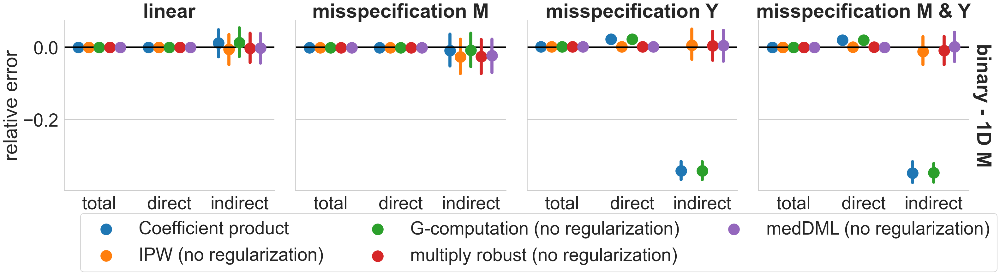

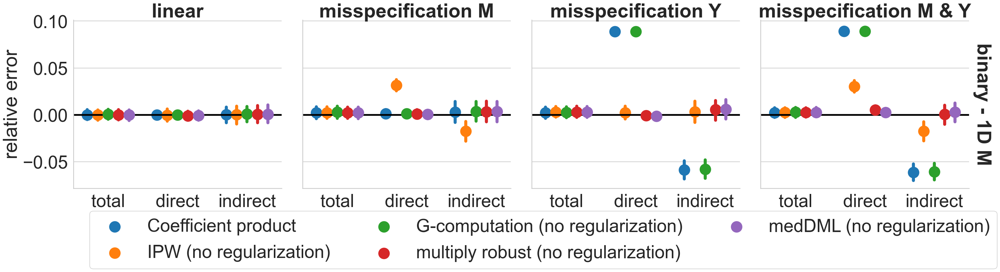

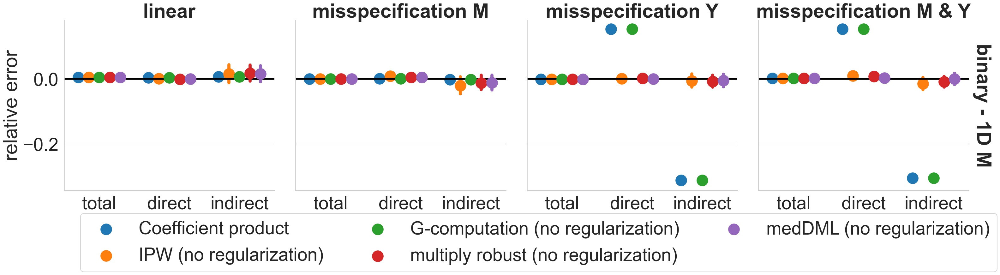

In [33]:
for conf in all_configs:
    g = sns.catplot(x="effect_name", y="relative error", hue="nice_estimator",
            col="setting_name", row='configuration',
            data=res_df_melt[(res_df_melt.med_setting==conf)&(res_df_melt.nice_estimator.isin(most_basic_estimators))&(res_df_melt.n==1000)&(res_df_melt.configuration=='binary - 1D M')],
            aspect=1.3, height=7,
            kind='point', sharey='row', margin_titles=True, dodge=0.6,
            capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
            facet_kws={"gridspec_kws": {"hspace":0.1}})
    for i in range(g.axes.shape[0]):
        for j in range(g.axes.shape[1]):
            true_val = 0
            g.axes[i, j].axhline(y=true_val, color="black", lw=4)
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    for ax in g.axes.ravel():
        ax.set_xlabel(ax.get_xlabel().replace('effect_name', ''))


    plt.subplots_adjust(hspace=0.1, wspace=0.1)
    g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
    hh = plt.setp(g._legend.get_texts(), fontsize=55)
    sns.move_legend(g, "lower left", bbox_to_anchor=(0.13, -0.3), ncol=3,
                    frameon=True, title=None, bbox_transform=g.fig.transFigure)

    g.legend.set_in_layout(in_layout=True)

    plt.savefig('{}/{}_all_effect_1000_binaryM.pdf'.format(output_path, conf),
                bbox_extra_artists=(g.legend,), bbox_inches='tight')
    

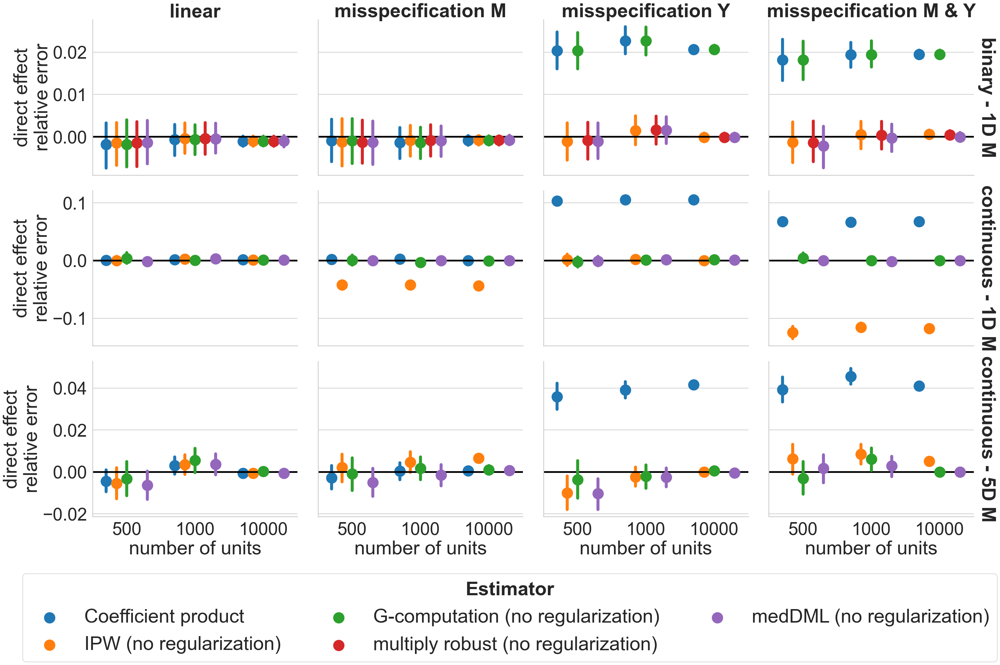

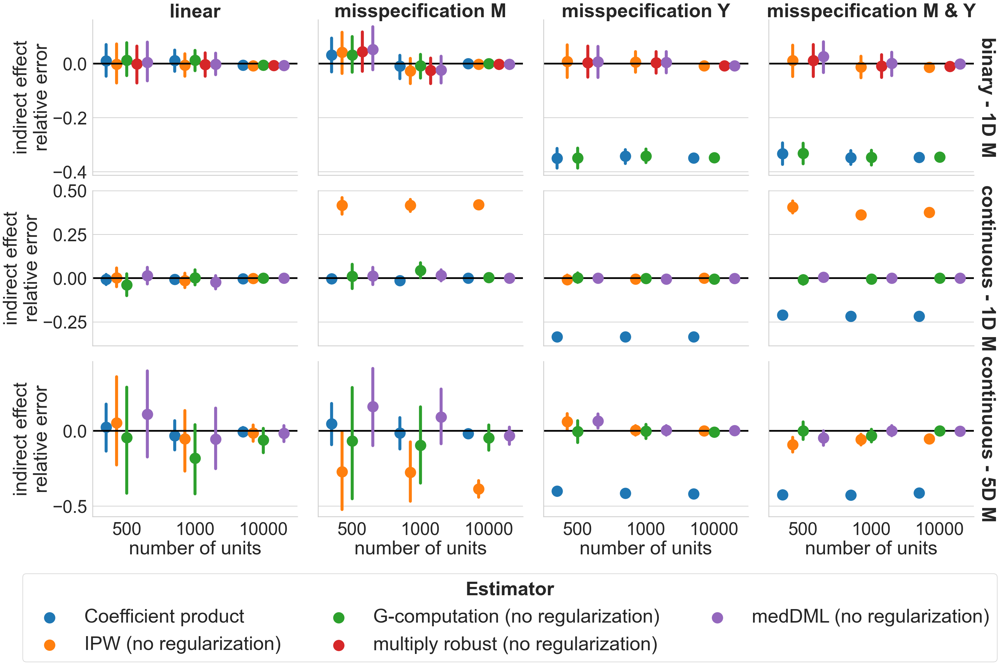

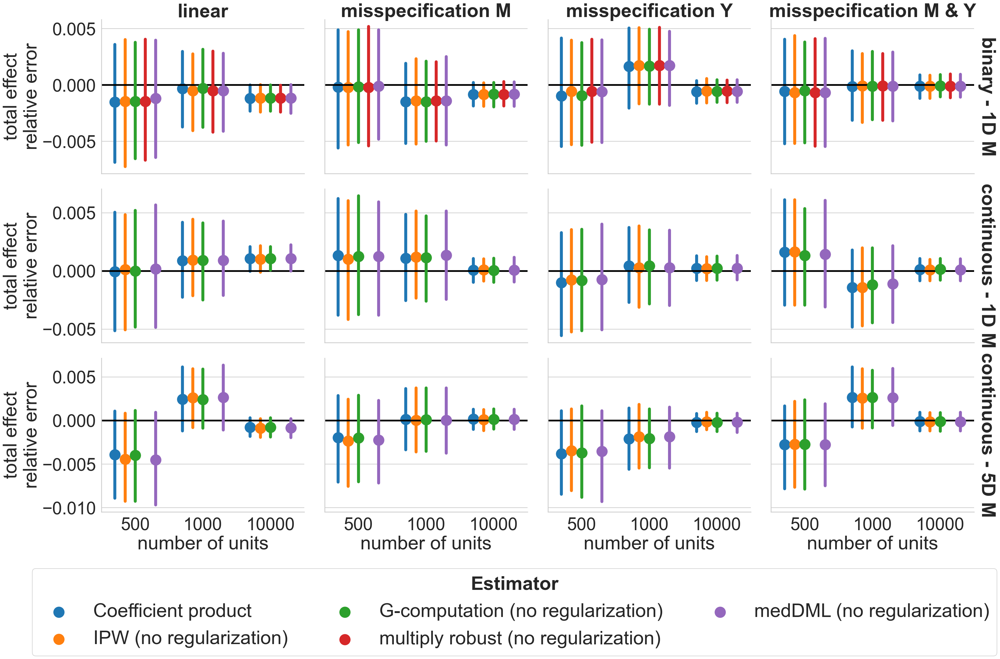

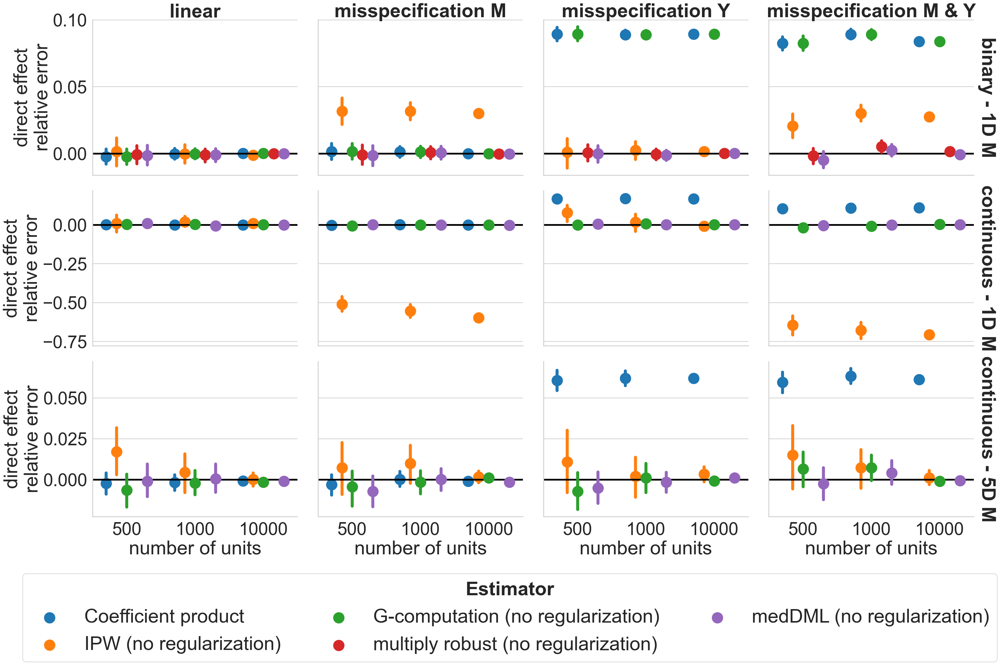

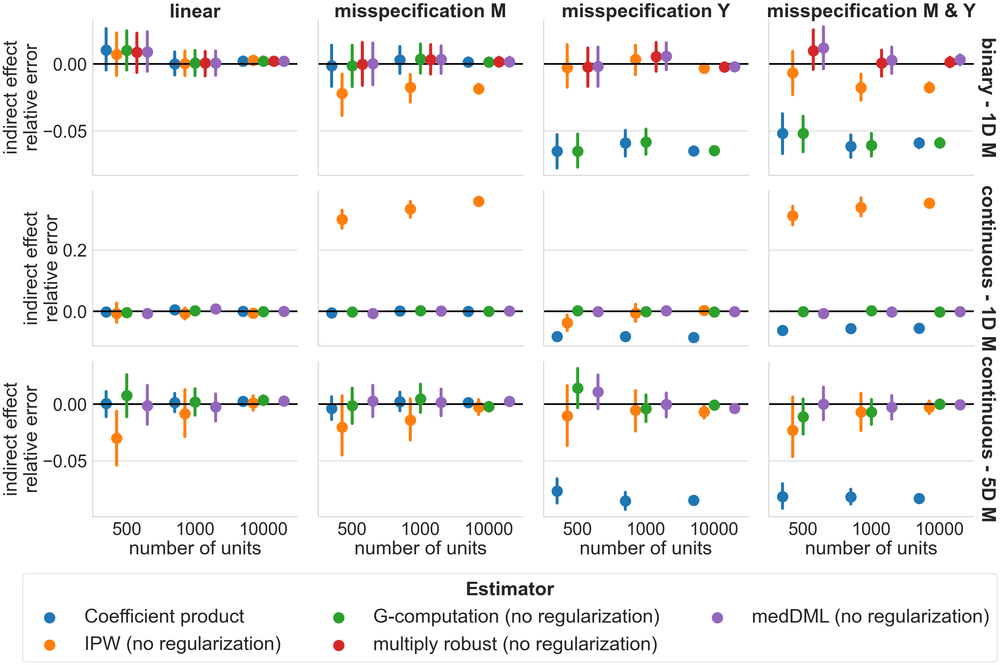

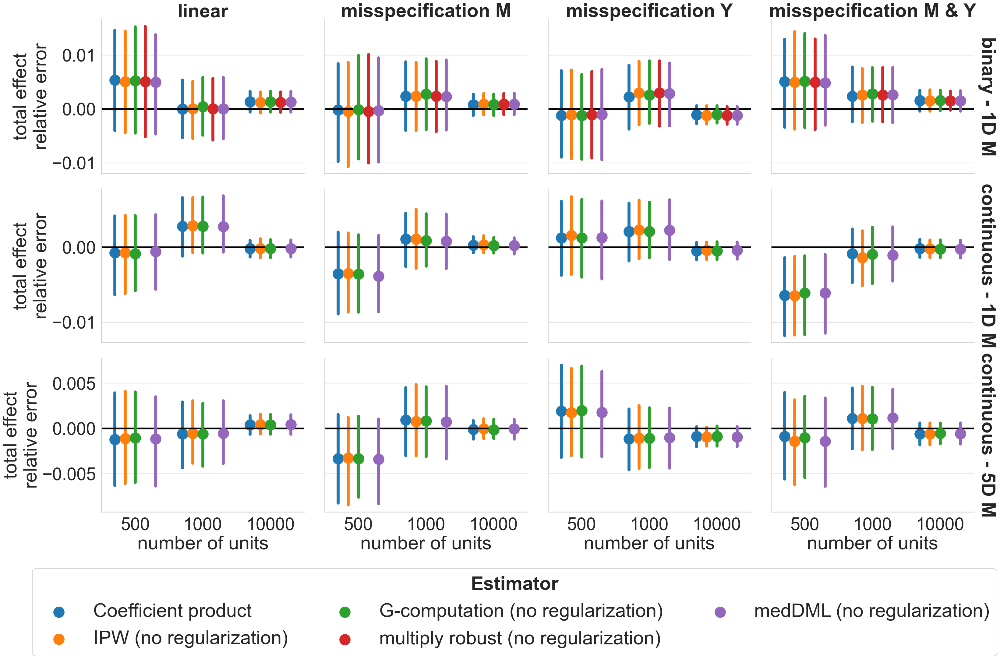

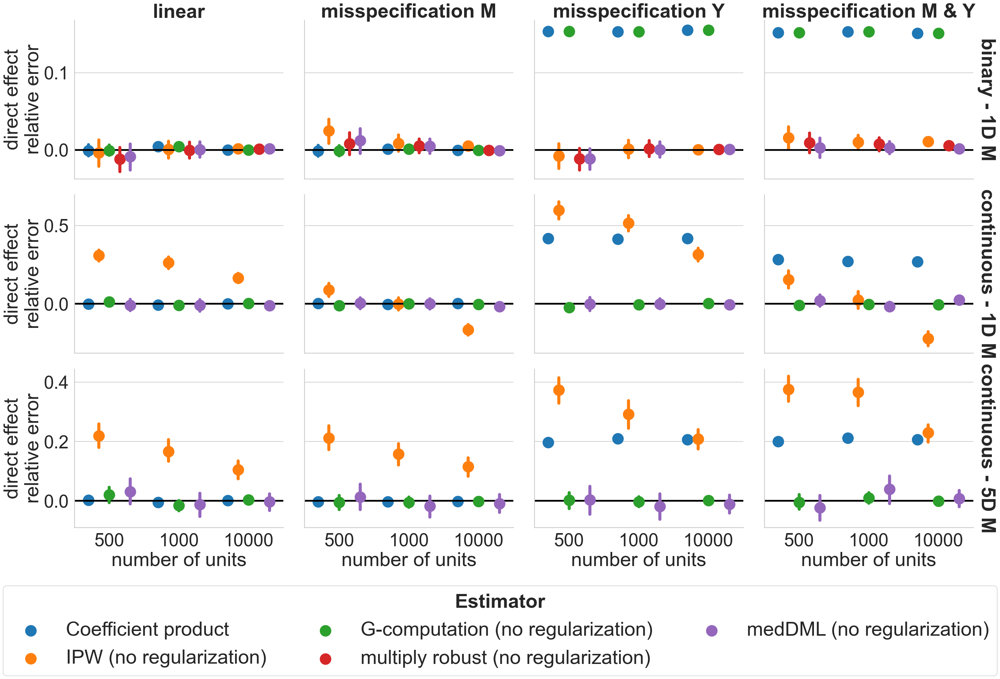

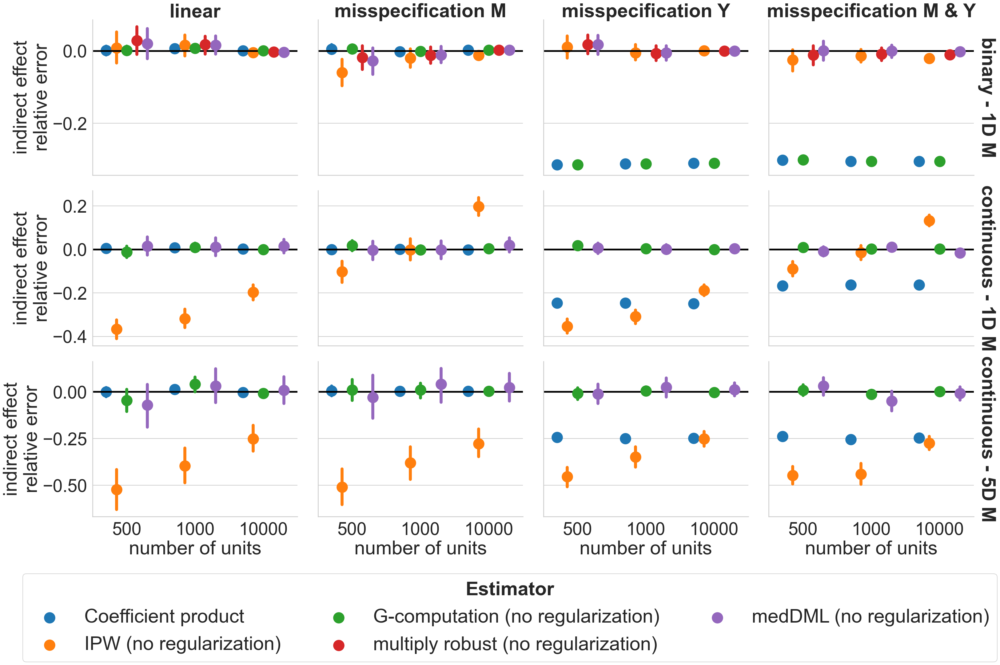

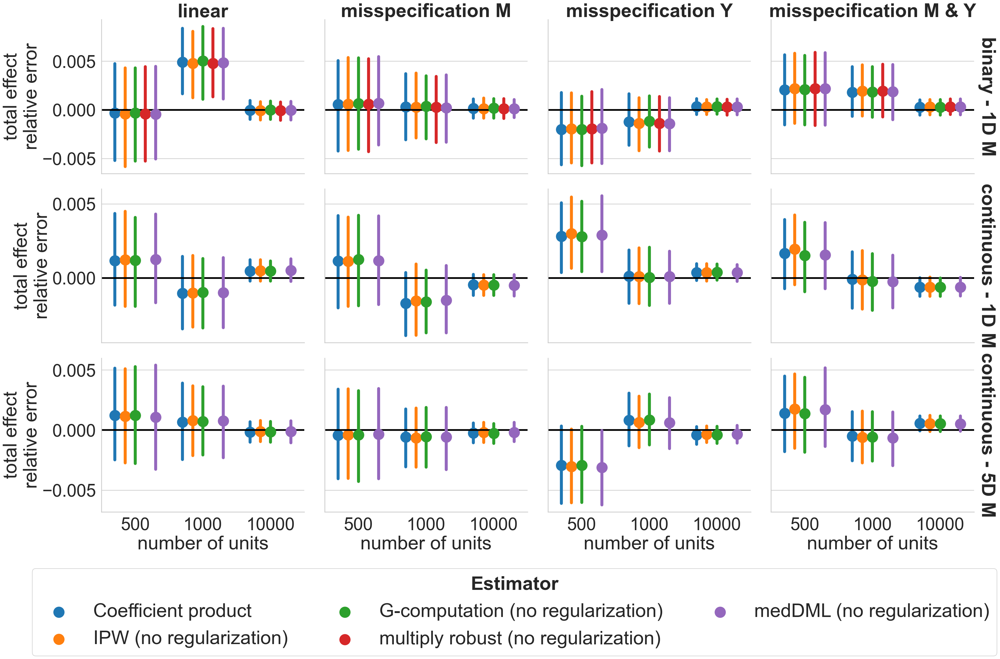

In [67]:
for conf in all_configs:
    for effect in ['direct', 'indirect', 'total']:
        g = sns.catplot(x="n", y="{}_effect_error".format(effect), hue="nice_estimator",
                col="setting_name", row='configuration',
                data=res_df[(res_df.med_setting==conf)&(res_df.nice_estimator.isin(most_basic_estimators))],
                aspect=1.3, height=7,
                kind='point', sharey='row', margin_titles=True, dodge=0.6,
                capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
                facet_kws={"gridspec_kws": {"hspace":0.1}})
        for i in range(g.axes.shape[0]):
            for j in range(g.axes.shape[1]):
                true_val = 0
                g.axes[i, j].axhline(y=true_val, color="black", lw=4)
        [plt.setp(ax.texts, text="") for ax in g.axes.flat]
        for ax in g.axes.ravel():
            ax.set_xlabel(ax.get_xlabel().replace('n', 'number of units'))
            ax.set_ylabel(ax.get_ylabel().replace("{}_effect_error".format(effect), 
                                                 '{} effect\nrelative error'.format(effect)))

        plt.subplots_adjust(hspace=0.1, wspace=0.1)
        g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
        hh = plt.setp(g._legend.get_texts(), fontsize=55)
        sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.13), ncol=3,
                        frameon=True, title="Estimator",
                        title_fontproperties={'weight':'bold'},
                        bbox_transform=g.fig.transFigure, fontsize=45)

        g._legend.set_in_layout(in_layout=True)


        plt.savefig('{}/{}_{}_effect.pdf'.format(output_path, conf, effect),
                    bbox_extra_artists=(g._legend, ), bbox_inches='tight')

In [35]:
all_configs

['prop_low_no_overlap_violation',
 'prop_high_no_overlap_violation',
 'prop_high_strong_overlap_violation']

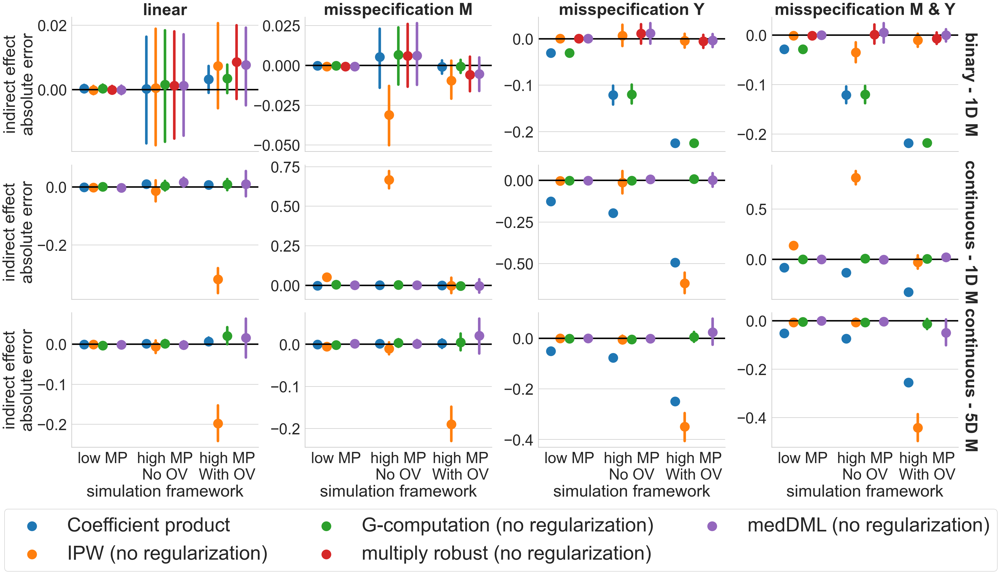

In [51]:
effect = 'indirect'
res_df = res_df.assign(abs_indirect_effect_error=(res_df.indirect_treated_effect-res_df.indirect_1))
med_setting_nice = {'prop_low_no_overlap_violation': 'low MP',
                    'prop_high_no_overlap_violation': 'high MP\nNo OV',
                    'prop_high_strong_overlap_violation': 'high MP\nWith OV'}
res_df = res_df.assign(nice_med_setting=res_df.med_setting.map(med_setting_nice))

g = sns.catplot(x="nice_med_setting", y="abs_indirect_effect_error", hue="nice_estimator",
        col="setting_name", row='configuration',
        data=res_df[(res_df.nice_estimator.isin(most_basic_estimators))&(res_df.n==1000)],
        aspect=1.5, height=7,
        kind='point', sharey=False, margin_titles=True, dodge=0.6,
        capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
        facet_kws={"gridspec_kws": {"hspace":0.1}})
for i in range(g.axes.shape[0]):
    for j in range(g.axes.shape[1]):
        true_val = 0
        g.axes[i, j].axhline(y=true_val, color="black", lw=4)
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
for ax in g.axes.ravel():
    ax.set_xlabel(ax.get_xlabel().replace('nice_med_setting', 'simulation framework'))
    ax.set_ylabel(ax.get_ylabel().replace("abs_{}_effect_error".format(effect), 
                                         '{} effect\nabsolute error'.format(effect)))

plt.subplots_adjust(hspace=0.1, wspace=0.25)
g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
hh = plt.setp(g._legend.get_texts(), fontsize=65)
sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.13), ncol=3,
                frameon=True, title=None, bbox_transform=g.fig.transFigure,
               fontsize=53)

g.legend.set_in_layout(in_layout=True)

plt.savefig('{}/effect_conf_all_effect_1000_abs.pdf'.format(output_path),
            bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

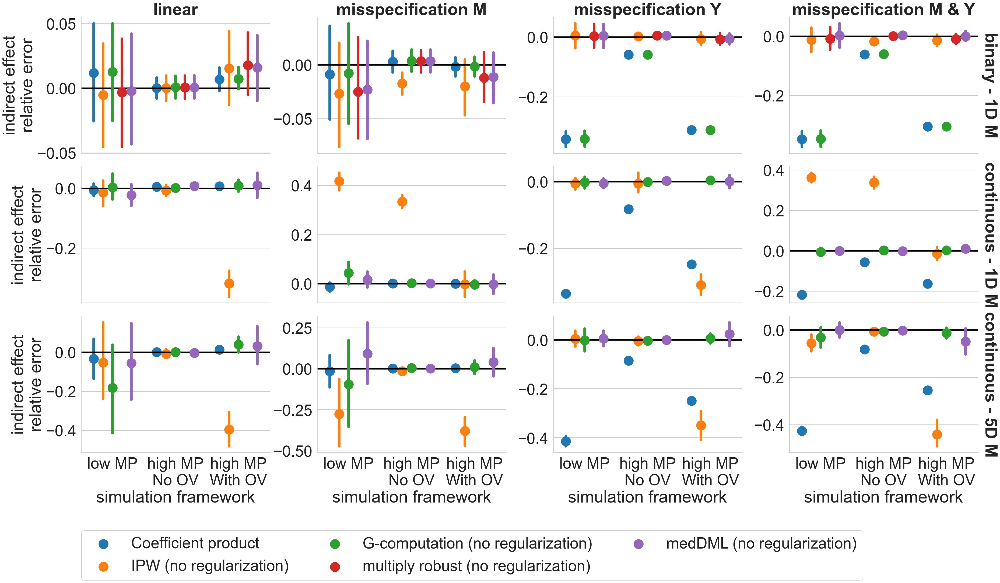

In [37]:
effect = 'indirect'

g = sns.catplot(x="nice_med_setting", y="indirect_effect_error", hue="nice_estimator",
        col="setting_name", row='configuration',
        data=res_df[(res_df.nice_estimator.isin(most_basic_estimators))&(res_df.n==1000)],
        aspect=1.5, height=7,
        kind='point', sharey=False, margin_titles=True, dodge=0.6,
        capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
        facet_kws={"gridspec_kws": {"hspace":0.1}})
for i in range(g.axes.shape[0]):
    for j in range(g.axes.shape[1]):
        true_val = 0
        g.axes[i, j].axhline(y=true_val, color="black", lw=4)
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
for ax in g.axes.ravel():
    ax.set_xlabel(ax.get_xlabel().replace('nice_med_setting', 'simulation framework'))
    ax.set_ylabel(ax.get_ylabel().replace("{}_effect_error".format(effect), 
                                         '{} effect\nrelative error'.format(effect)))

plt.subplots_adjust(hspace=0.1, wspace=0.25)
g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
hh = plt.setp(g._legend.get_texts(), fontsize=55)
sns.move_legend(g, "lower left", bbox_to_anchor=(0.12, -0.13), ncol=3,
                frameon=True, title=None, bbox_transform=g.fig.transFigure)

g.legend.set_in_layout(in_layout=True)

plt.savefig('{}/effect_conf_all_effect_1000.pdf'.format(output_path),
            bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

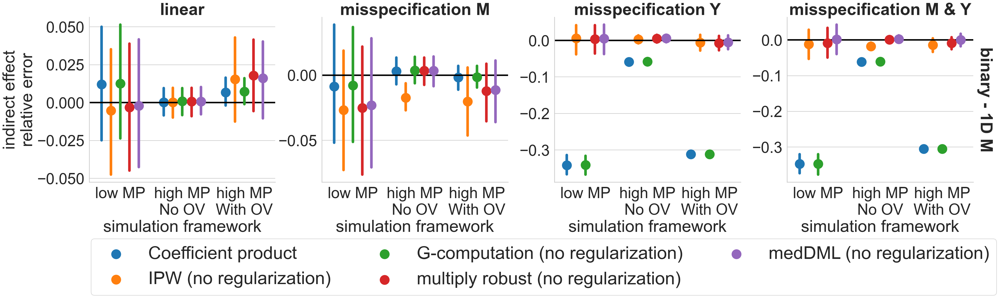

In [68]:
effect = 'indirect'

g = sns.catplot(x="nice_med_setting", y="indirect_effect_error", hue="nice_estimator",
        col="setting_name", row='configuration',
        data=res_df[(res_df.nice_estimator.isin(most_basic_estimators))&(res_df.n==1000)&(res_df.configuration=='binary - 1D M')],
        aspect=1.3, height=8,
        kind='point', sharey=False, margin_titles=True, dodge=0.6,
        capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
        facet_kws={"gridspec_kws": {"hspace":0.1}})
for i in range(g.axes.shape[0]):
    for j in range(g.axes.shape[1]):
        true_val = 0
        g.axes[i, j].axhline(y=true_val, color="black", lw=4)
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
for ax in g.axes.ravel():
    ax.set_xlabel(ax.get_xlabel().replace('nice_med_setting', 'simulation framework'))
    ax.set_ylabel(ax.get_ylabel().replace("{}_effect_error".format(effect), 
                                         '{} effect\nrelative error'.format(effect)))

plt.subplots_adjust(hspace=0.1, wspace=0.25)
g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
hh = plt.setp(g._legend.get_texts(), fontsize=55)
sns.move_legend(g, "lower left", bbox_to_anchor=(0.12, -0.46), ncol=3,
                frameon=True, title=None, bbox_transform=g.fig.transFigure, fontsize=48)

g.legend.set_in_layout(in_layout=True)

plt.savefig('{}/effect_conf_all_effect_1000_binaryM.pdf'.format(output_path),
            bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

In [39]:
res_df_melt_coverage = pd.melt(res_df,
                      id_vars=[c for c in res_df.columns if 'contains_true' not in c],
                     value_vars=[c for c in res_df.columns if 'contains_true' in c],
                     value_name='coverage')
res_df_melt_coverage = res_df_melt_coverage.assign(coverage_name=res_df_melt_coverage.variable.str.replace('_effect_contains_true', ''))
res_df_melt_coverage = res_df_melt_coverage[res_df_melt_coverage.coverage_name.isin(['total', 'direct_control', 'indirect_treated'])]
res_df_melt_coverage = res_df_melt_coverage.assign(coverage_name=res_df_melt_coverage.coverage_name.str.split('_').str.get(0))

res_df_melt_coverage = res_df_melt_coverage[(res_df_melt_coverage.base_estimator!='multiply robust')|(res_df_melt_coverage.type_m=='binary')]
res_df_melt_coverage = res_df_melt_coverage[(~res_df_melt_coverage.estimator.str.contains('mediation_g_computation_exp'))|(res_df_melt_coverage.type_m=='binary')]

res_df_melt_coverage.sample(5)

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_interval_width,direct_treated_effect_interval_width,direct_control_effect_interval_width,indirect_treated_effect_interval_width,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting,variable,coverage,coverage_name
340131,178,500,5,1,binary,4.0,2.0,False,False,0.285236,1.678876,1.200000,1.200000,0.478876,0.478876,mediation_DML_forest_cf,1.532238,1.114702,1.461852,0.070386,0.417536,2.944379,1.410940,1.634024,1.053614,1.246299,1.316890,1.603123,-0.008220,0.141145,0.283142,0.460082,0.223084,0.192685,0.286234,0.149364,0.176940,1.741864e+09,prop_high_strong_overlap_violation,medDML (forest & cross-fitting),True,True,False,medDML,-0.087343,0.218210,-0.853019,binary - 1D M,linear,-0.408491,high MP\nWith OV,total_effect_contains_true,False,total
254989,133,1000,5,5,continuous,1.0,1.0,False,True,0.454922,2.198181,1.698181,1.198181,1.000000,0.500000,mediation_ipw_noreg,2.188058,1.936054,1.548346,0.639712,0.252004,0.071821,2.135496,2.239854,1.646520,2.118439,1.215374,1.885788,0.305789,0.967727,0.068874,0.567493,0.104358,0.471919,0.670415,0.661938,0.498619,1.741181e+09,prop_high_strong_overlap_violation,IPW (no regularization),False,False,False,IPW,-0.004605,0.292247,-0.360288,continuous - 5D M,misspecification Y,-0.360288,high MP\nWith OV,total_effect_contains_true,True,total
1158174,7,500,5,1,binary,0.5,0.5,True,True,0.053575,1.530568,1.503234,1.448567,0.082001,0.027334,mediation_DML_reg_cf,1.600833,1.578245,1.517084,0.083749,0.022588,1.554507,1.497440,1.695003,1.477388,1.653255,1.407009,1.605457,0.011198,0.152348,-0.004278,0.057378,0.197564,0.175866,0.198449,0.141150,0.061656,1.741177e+09,prop_low_no_overlap_violation,medDML (regularization & cross-fitting),False,True,True,medDML,0.045908,0.047300,0.021322,binary - 1D M,misspecification M & Y,0.001748,low MP,indirect_treated_effect_contains_true,True,indirect
1419589,144,500,5,1,binary,0.5,0.5,False,True,0.057741,1.539772,1.510136,1.450864,0.088907,0.029636,mediation_DML_noreg,1.493491,1.477017,1.426674,0.066817,0.016474,0.167283,1.396740,1.605473,1.388926,1.590010,1.337943,1.534994,0.006948,0.131960,0.002366,0.051401,0.208733,0.201085,0.197051,0.125013,0.049035,1.741182e+09,prop_low_no_overlap_violation,medDML (no regularization),False,False,False,medDML,-0.030057,-0.016673,-0.248466,binary - 1D M,misspecification Y,-0.022090,low MP,indirect_treated_effect_contains_true,True,indirect
929417,87,500,5,1,binary,2.0,10.0,True,True,0.578128,3.441262,1.632636,1.451773,1.989488,1.808626,mediation_g_computation_exp_reg_cf,3.578598,1.574712,1.574712,2.003886,2.003886,0.492960,1.537206,4.057150,1.432243,1.698356,1.432243,1.698356,0.000252,2.486581,0.000252,2.486581,2.519944,0.266114,0.266114,2.486329,2.486329,1.741179e+09,prop_high_no_overlap_violation,G-computation (regularization & cross-fitting),False,True,True,G-computation,0.039909,0.084682,0.007237,binary - 1D M,misspecification M & Y,0.014397,high MP\nNo OV,direct_control_effect_contains_true,True,direct


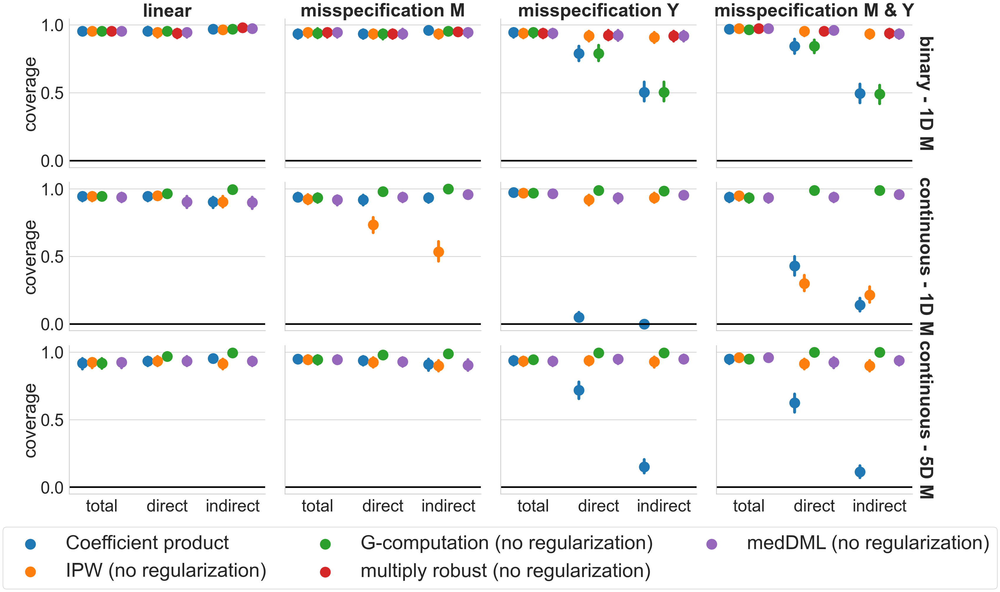

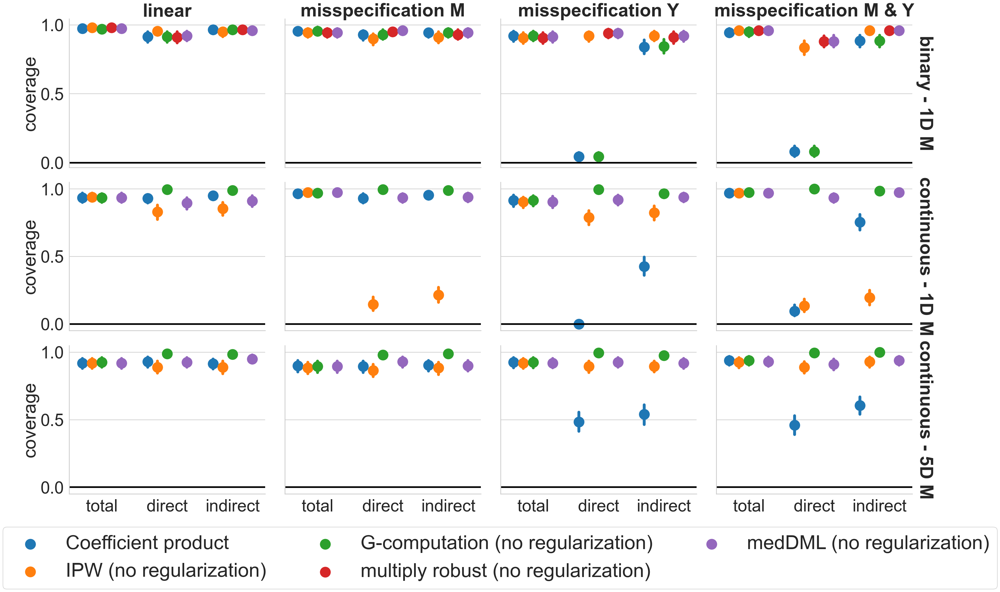

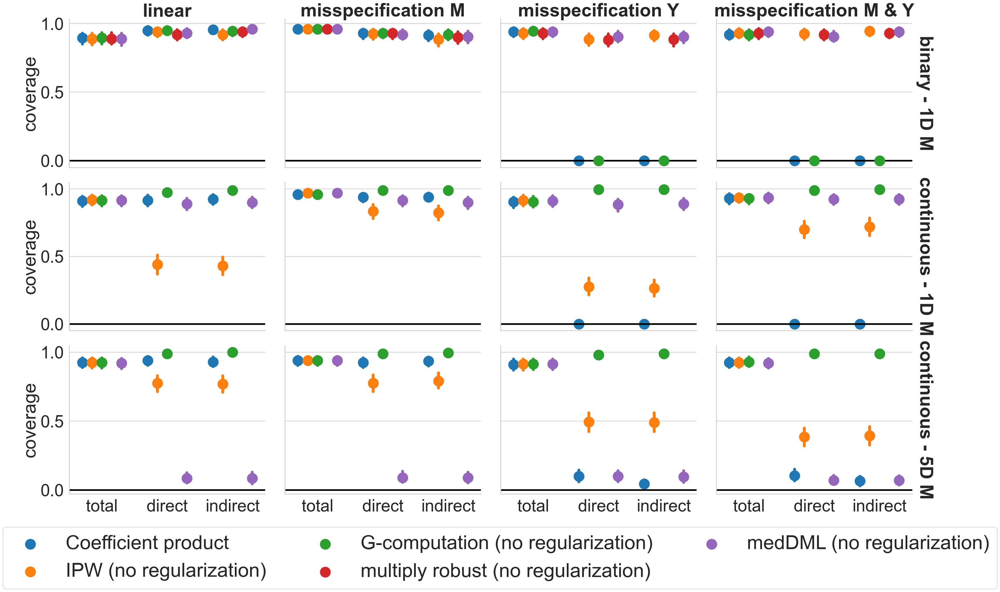

In [53]:
for conf in all_configs:
    g = sns.catplot(x="coverage_name", y="coverage", hue="nice_estimator",
            col="setting_name", row='configuration',
            data=res_df_melt_coverage[(res_df_melt_coverage.med_setting==conf)&(res_df_melt_coverage.nice_estimator.isin(most_basic_estimators))&(res_df_melt_coverage.n==1000)],
            aspect=1.3, height=7,
            kind='point', sharey='row', margin_titles=True, dodge=0.6,
            capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
            facet_kws={"gridspec_kws": {"hspace":0.1}})
    for i in range(g.axes.shape[0]):
        for j in range(g.axes.shape[1]):
            true_val = 0
            g.axes[i, j].axhline(y=true_val, color="black", lw=4)
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    for ax in g.axes.ravel():
        ax.set_xlabel(ax.get_xlabel().replace('coverage_name', ''))


    plt.subplots_adjust(hspace=0.1, wspace=0.1)
    g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
    hh = plt.setp(g._legend.get_texts(), fontsize=55)
    sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.06), ncol=3,
                    frameon=True, title=None, bbox_transform=g.fig.transFigure, fontsize=48)

    g.legend.set_in_layout(in_layout=True)

    plt.savefig('{}/{}_all_coverage_1000.pdf'.format(output_path, conf),
                bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

In [41]:
res_df.head()

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting
0,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,coefficient_product,1.523545,1.470279,1.470279,0.053266,0.053266,0.104086,1.420253,1.606637,1.386472,1.550347,1.386472,1.550347,0.003102,0.096086,0.003102,0.096086,True,0.186384,True,0.163875,True,0.163875,True,0.092984,True,0.092984,1.741176e+09,prop_low_no_overlap_violation,Coefficient product,False,False,False,Coefficient product,-0.006168,0.013405,-0.351764,binary - 1D M,misspecification M & Y,-0.028905,low MP
1,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_noreg,1.518898,1.487598,1.444149,0.074749,0.031300,0.076701,1.416778,1.602655,1.401856,1.563469,1.355329,1.532069,0.004115,0.129807,0.001398,0.068193,True,0.185877,True,0.161613,True,0.176740,True,0.125692,True,0.066795,1.741176e+09,prop_low_no_overlap_violation,IPW (no regularization),False,False,False,IPW,-0.009199,-0.004605,-0.090319,binary - 1D M,misspecification M & Y,-0.007422,low MP
2,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg,1.545092,1.489956,1.441118,0.103975,0.055137,0.231434,1.426136,1.607725,1.410763,1.582901,1.376152,1.561818,-0.024622,0.135509,-0.012911,0.071225,True,0.181589,True,0.172138,True,0.185666,True,0.160131,True,0.084136,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization),False,False,True,IPW,0.007887,-0.006694,0.265348,binary - 1D M,misspecification M & Y,0.021804,low MP
3,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_forest,1.526911,1.522203,1.496089,0.030822,0.004708,0.522162,1.426685,1.592737,1.432337,1.597024,1.420143,1.571583,-0.004881,0.058802,-0.012702,0.022168,True,0.166052,True,0.164687,True,0.151441,False,0.063683,False,0.034870,1.741176e+09,prop_low_no_overlap_violation,IPW (forest),True,False,False,IPW,-0.003972,0.031195,-0.624902,binary - 1D M,misspecification M & Y,-0.051349,low MP
4,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg_cf,1.527076,1.517817,1.499933,0.027143,0.009259,0.476440,1.423605,1.610887,1.421778,1.580106,1.383297,1.569722,-0.031510,0.124352,-0.026873,0.059338,True,0.187282,True,0.158328,True,0.186425,True,0.155863,True,0.086211,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization & cross-fitting),False,True,True,IPW,-0.003865,0.033845,-0.669679,binary - 1D M,misspecification M & Y,-0.055028,low MP


In [42]:
res_df_melt_width = pd.melt(res_df,
                      id_vars=[c for c in res_df.columns if 'interval_width' not in c],
                     value_vars=[c for c in res_df.columns if 'interval_width' in c],
                     value_name='interval width')
res_df_melt_width = res_df_melt_width.assign(width_name=res_df_melt_width.variable.str.replace('_effect_interval_width', ''))
res_df_melt_width = res_df_melt_width[res_df_melt_width.width_name.isin(['total', 'direct_control', 'indirect_treated'])]
res_df_melt_width = res_df_melt_width.assign(width_name=res_df_melt_width.width_name.str.split('_').str.get(0))
res_df_melt_width = res_df_melt_width[(res_df_melt_width.base_estimator!='multiply robust')|(res_df_melt_width.type_m=='binary')]
res_df_melt_width = res_df_melt_width[(~res_df_melt_width.estimator.str.contains('mediation_g_computation_exp'))|(res_df_melt_width.type_m=='binary')]

res_df_melt_width.sample(5)

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,direct_treated_effect_contains_true,direct_control_effect_contains_true,indirect_treated_effect_contains_true,indirect_control_effect_contains_true,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting,variable,interval width,width_name
932607,88,10000,5,1,binary,2.0,10.0,True,True,0.576933,3.429150,1.630613,1.450759,1.978391,1.798537,mediation_DML_forest,3.427816,1.609057,1.441978,1.985838e+00,1.818759,14.138870,3.355098,3.516287,1.591319,1.636863,1.411426,1.467235,1.902537e+00,2.082796e+00,1.743224,1.904069,True,True,True,True,True,1.741180e+09,prop_high_no_overlap_violation,medDML (forest),True,False,False,medDML,-0.000389,-0.006053,0.003764,binary - 1D M,misspecification M & Y,0.007447,high MP\nNo OV,direct_control_effect_interval_width,5.580965e-02,direct
57966,30,1000,5,1,continuous,0.5,0.5,True,True,0.240902,1.577831,1.451130,1.197728,0.380103,0.126701,mediation_g_computation_imp_noreg,1.578318,1.446394,1.151719,4.265987e-01,0.131924,0.087170,1.510619,1.657780,1.345368,1.566018,1.067081,1.246734,3.271343e-01,5.049193e-01,0.050710,0.217116,True,True,True,True,True,1.741177e+09,prop_low_no_overlap_violation,G-computation (no regularization),False,False,False,G-computation,0.000309,-0.038414,0.122325,continuous - 1D M,misspecification M & Y,0.046496,low MP,total_effect_interval_width,1.471610e-01,total
174764,91,1000,5,1,binary,4.0,2.0,False,False,0.285885,1.680400,1.200000,1.200000,0.480400,0.480400,mediation_multiply_robust_forest,1.677342,1.182622,1.577598,9.974456e-02,0.494721,1.482954,1.608090,1.751880,1.124460,1.242155,NaN,NaN,NaN,NaN,0.429245,0.548327,True,True,False,False,True,1.741180e+09,prop_high_strong_overlap_violation,multiply robust (forest),True,False,False,multiply robust,-0.001820,0.314665,-0.792372,binary - 1D M,linear,-0.380656,high MP\nWith OV,total_effect_interval_width,1.437905e-01,total
361272,189,1000,5,1,binary,0.5,0.5,False,True,0.057500,1.539676,1.510165,1.451144,0.088531,0.029510,mediation_ipw_forest,1.551056,1.539622,1.513535,3.752103e-02,0.011434,0.684627,1.492848,1.614760,1.482662,1.605166,1.459749,1.573599,1.164832e-02,7.316069e-02,-0.005276,0.024395,True,True,False,False,False,1.741871e+09,prop_low_no_overlap_violation,IPW (forest),True,False,False,IPW,0.007391,0.042994,-0.576184,binary - 1D M,misspecification Y,-0.051010,low MP,total_effect_interval_width,1.219127e-01,total
1454351,162,500,5,1,binary,4.0,2.0,False,True,0.332002,2.170652,1.690212,1.449992,0.720660,0.480440,mediation_g_computation_exp_forest_cf,2.094500,1.816376,2.094500,1.207923e-16,0.278124,0.927047,1.988764,2.187282,1.717754,1.909299,1.988764,2.187282,-2.564837e-16,2.879474e-16,0.222406,0.344127,True,False,False,False,False,1.741182e+09,prop_high_strong_overlap_violation,G-computation (forest & cross-fitting),True,True,False,G-computation,-0.035083,0.444491,-1.000000,binary - 1D M,misspecification Y,-0.720660,high MP\nWith OV,indirect_treated_effect_interval_width,5.444312e-16,indirect


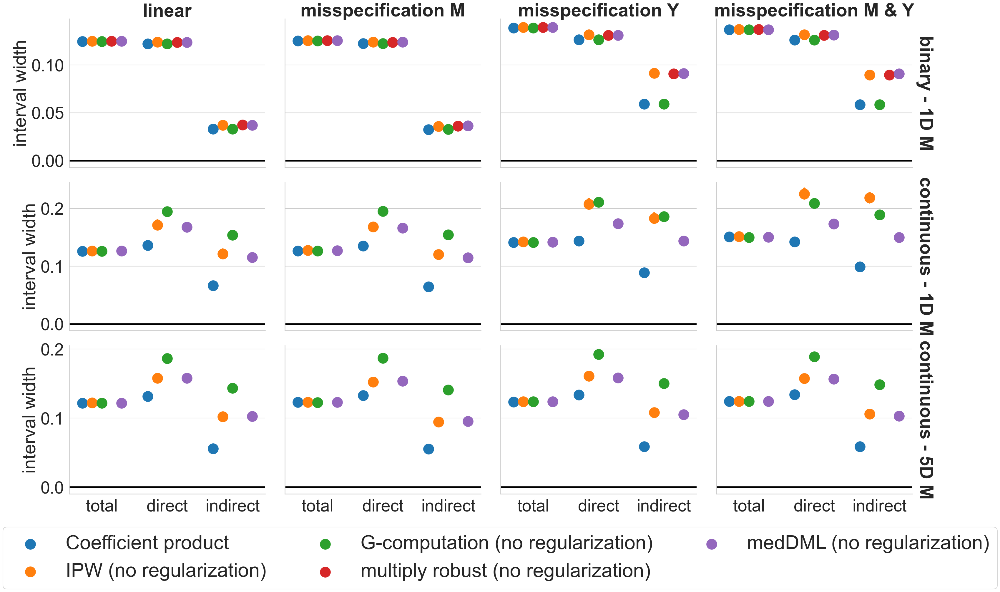

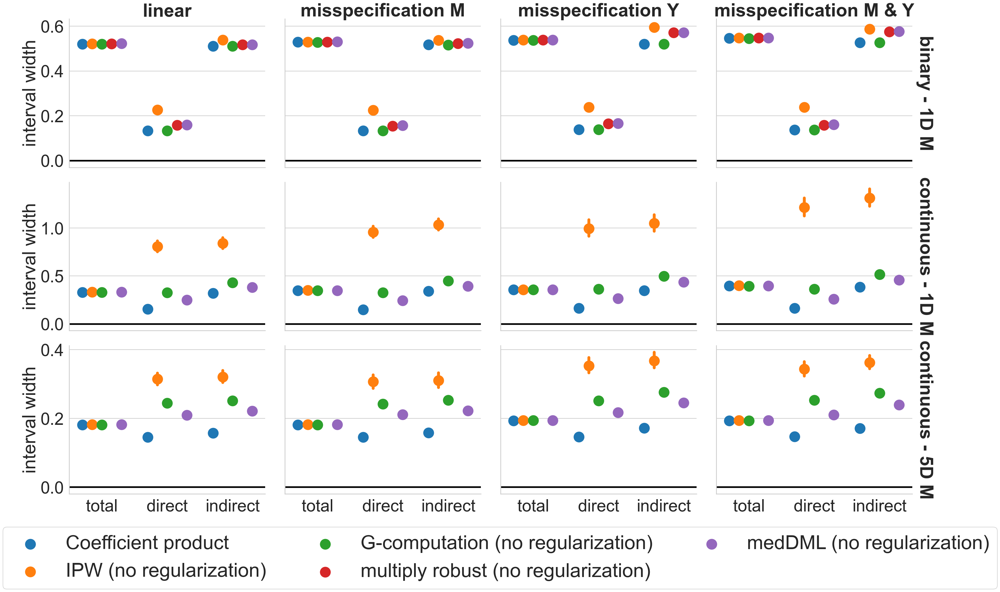

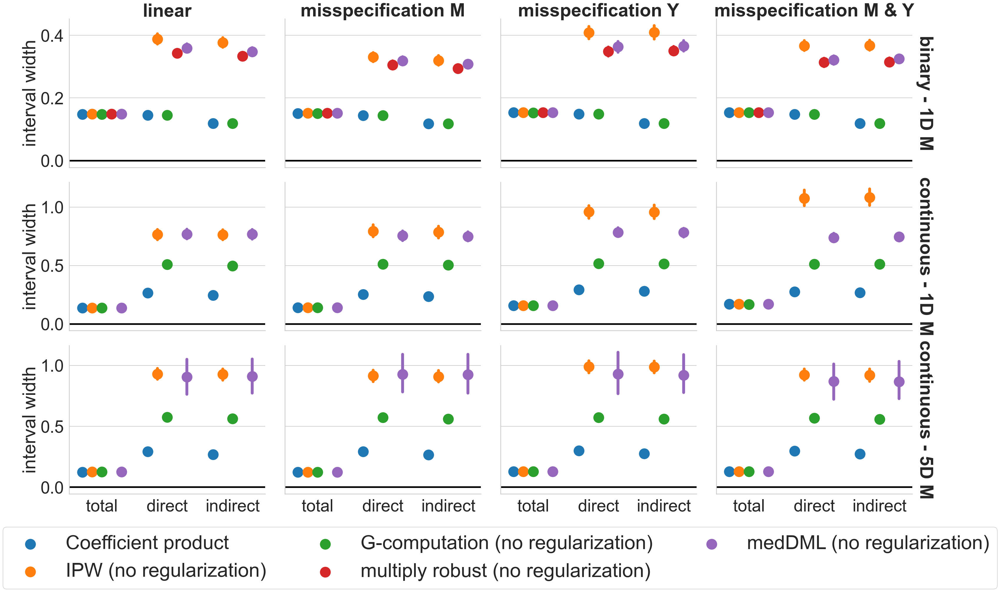

In [54]:
for conf in all_configs:
    g = sns.catplot(x="width_name", y="interval width", hue="nice_estimator",
            col="setting_name", row='configuration',
            data=res_df_melt_width[(res_df_melt_width.med_setting==conf)&(res_df_melt_width.nice_estimator.isin(most_basic_estimators))&(res_df_melt_coverage.n==1000)],
            aspect=1.3, height=7,
            kind='point', sharey='row', margin_titles=True, dodge=0.6,
            capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
            facet_kws={"gridspec_kws": {"hspace":0.1}})
    for i in range(g.axes.shape[0]):
        for j in range(g.axes.shape[1]):
            true_val = 0
            g.axes[i, j].axhline(y=true_val, color="black", lw=4)
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    for ax in g.axes.ravel():
        ax.set_xlabel(ax.get_xlabel().replace('width_name', ''))
        ax.set_ylim


    plt.subplots_adjust(hspace=0.1, wspace=0.1)
    g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
    hh = plt.setp(g._legend.get_texts(), fontsize=55)
    sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.06), ncol=3,
                    frameon=True, title=None, bbox_transform=g.fig.transFigure, fontsize=48)

    g.legend.set_in_layout(in_layout=True)

    plt.savefig('{}/{}_all_width_1000.pdf'.format(output_path, conf),
                bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

In [44]:
res_df.head()

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting
0,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,coefficient_product,1.523545,1.470279,1.470279,0.053266,0.053266,0.104086,1.420253,1.606637,1.386472,1.550347,1.386472,1.550347,0.003102,0.096086,0.003102,0.096086,True,0.186384,True,0.163875,True,0.163875,True,0.092984,True,0.092984,1.741176e+09,prop_low_no_overlap_violation,Coefficient product,False,False,False,Coefficient product,-0.006168,0.013405,-0.351764,binary - 1D M,misspecification M & Y,-0.028905,low MP
1,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_noreg,1.518898,1.487598,1.444149,0.074749,0.031300,0.076701,1.416778,1.602655,1.401856,1.563469,1.355329,1.532069,0.004115,0.129807,0.001398,0.068193,True,0.185877,True,0.161613,True,0.176740,True,0.125692,True,0.066795,1.741176e+09,prop_low_no_overlap_violation,IPW (no regularization),False,False,False,IPW,-0.009199,-0.004605,-0.090319,binary - 1D M,misspecification M & Y,-0.007422,low MP
2,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg,1.545092,1.489956,1.441118,0.103975,0.055137,0.231434,1.426136,1.607725,1.410763,1.582901,1.376152,1.561818,-0.024622,0.135509,-0.012911,0.071225,True,0.181589,True,0.172138,True,0.185666,True,0.160131,True,0.084136,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization),False,False,True,IPW,0.007887,-0.006694,0.265348,binary - 1D M,misspecification M & Y,0.021804,low MP
3,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_forest,1.526911,1.522203,1.496089,0.030822,0.004708,0.522162,1.426685,1.592737,1.432337,1.597024,1.420143,1.571583,-0.004881,0.058802,-0.012702,0.022168,True,0.166052,True,0.164687,True,0.151441,False,0.063683,False,0.034870,1.741176e+09,prop_low_no_overlap_violation,IPW (forest),True,False,False,IPW,-0.003972,0.031195,-0.624902,binary - 1D M,misspecification M & Y,-0.051349,low MP
4,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg_cf,1.527076,1.517817,1.499933,0.027143,0.009259,0.476440,1.423605,1.610887,1.421778,1.580106,1.383297,1.569722,-0.031510,0.124352,-0.026873,0.059338,True,0.187282,True,0.158328,True,0.186425,True,0.155863,True,0.086211,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization & cross-fitting),False,True,True,IPW,-0.003865,0.033845,-0.669679,binary - 1D M,misspecification M & Y,-0.055028,low MP


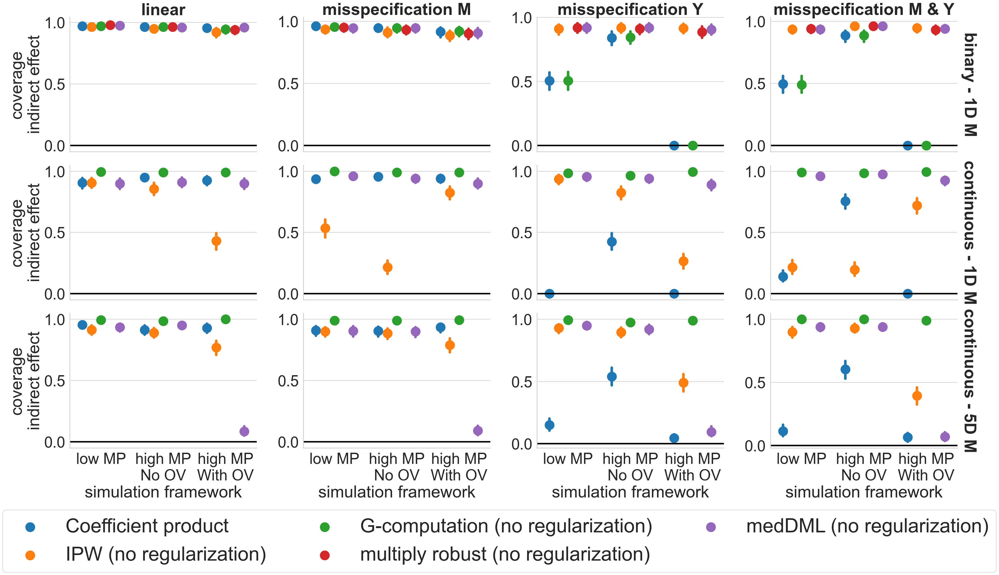

In [62]:
effect = 'indirect'

g = sns.catplot(x="nice_med_setting", y="indirect_treated_effect_contains_true", hue="nice_estimator",
        col="setting_name", row='configuration',
        data=res_df[(res_df.nice_estimator.isin(most_basic_estimators))&(res_df.n==1000)],
        aspect=1.5, height=7,
        kind='point', sharey=False, margin_titles=True, dodge=0.6,
        capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
        facet_kws={"gridspec_kws": {"hspace":0.1}})
for i in range(g.axes.shape[0]):
    for j in range(g.axes.shape[1]):
        true_val = 0
        g.axes[i, j].axhline(y=true_val, color="black", lw=4)
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
for ax in g.axes.ravel():
    ax.set_xlabel(ax.get_xlabel().replace('nice_med_setting', 'simulation framework'))
    ax.set_ylabel(ax.get_ylabel().replace("indirect_treated_effect_contains_true", 'coverage\nindirect effect'))

plt.subplots_adjust(hspace=0.1, wspace=0.25)
g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
hh = plt.setp(g._legend.get_texts(), fontsize=55)
sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.13), ncol=3,
                frameon=True, title=None, bbox_transform=g.fig.transFigure, fontsize=53)

g.legend.set_in_layout(in_layout=True)

plt.savefig('{}/effect_conf_all_coverage_1000.pdf'.format(output_path),
            bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

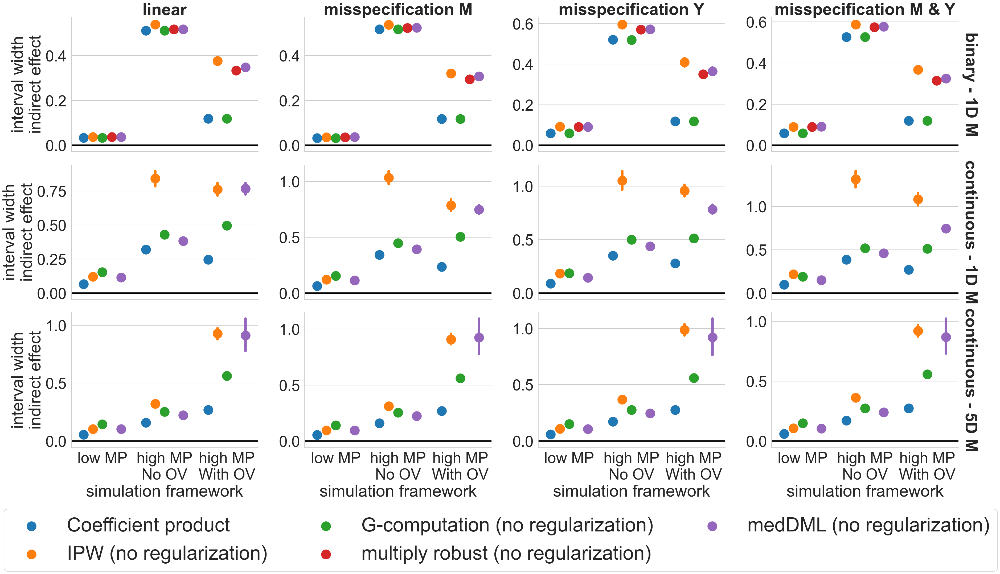

In [61]:
effect = 'indirect'

g = sns.catplot(x="nice_med_setting", y="indirect_treated_effect_interval_width", hue="nice_estimator",
        col="setting_name", row='configuration',
        data=res_df[(res_df.nice_estimator.isin(most_basic_estimators))&(res_df.n==1000)],
        aspect=1.5, height=7,
        kind='point', sharey=False, margin_titles=True, dodge=0.6,
        capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
        facet_kws={"gridspec_kws": {"hspace":0.1}})
for i in range(g.axes.shape[0]):
    for j in range(g.axes.shape[1]):
        true_val = 0
        g.axes[i, j].axhline(y=true_val, color="black", lw=4)
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
for ax in g.axes.ravel():
    ax.set_xlabel(ax.get_xlabel().replace('nice_med_setting', 'simulation framework'))
    ax.set_ylabel(ax.get_ylabel().replace('indirect_treated_effect_interval_width', 'interval width\nindirect effect'))

plt.subplots_adjust(hspace=0.1, wspace=0.25)
g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
hh = plt.setp(g._legend.get_texts(), fontsize=55)
sns.move_legend(g, "lower left", bbox_to_anchor=(0.07, -0.13), ncol=3,
                frameon=True, title=None, bbox_transform=g.fig.transFigure, fontsize=53)

g.legend.set_in_layout(in_layout=True)

plt.savefig('{}/effect_conf_all_width_1000.pdf'.format(output_path),
            bbox_extra_artists=(g.legend, ), bbox_inches='tight')
    

In [97]:
plot_dict = {
    'linear_vs_forest': ['G-computation (no regularization)',
                          'G-computation (forest)',
                          'IPW (no regularization)',
                          'IPW (forest)',
                          'multiply robust (no regularization)',
                          'multiply robust (forest)',
                          'medDML (no regularization)',
                          'medDML (forest)'],
    'linear_reg_vs_noreg': ['G-computation (no regularization)',
                          'G-computation (regularization)',
                          'IPW (no regularization)',
                          'IPW (regularization)',
                          'multiply robust (no regularization)',
                          'multiply robust (regularization)',
                          'medDML (no regularization)',
                          'medDML (regularization)'],
    'linear_reg_cf_vs_nocf': ['G-computation (regularization)',
                          'G-computation (regularization & cross-fitting)',
                          'IPW (regularization)',
                          'IPW (regularization & cross-fitting)',
                          'multiply robust (regularization)',
                          'multiply robust (regularization & cross-fitting)',
                          'medDML (regularization)',
                          'medDML (regularization & cross-fitting)'],
    'forest_cf_vs_nocf': ['G-computation (forest)',
                          'G-computation (forest & cross-fitting)',
                          'IPW (forest)',
                          'IPW (forest & cross-fitting)',
                          'multiply robust (forest)',
                          'multiply robust (forest & cross-fitting)',
                          'medDML (forest)',
                          'medDML (forest & cross-fitting)']
}

custom_paired_palette = ["#b2df8a", "#33a02c", "#fdbf6f", "#ff7f00", "#fb9a99", "#e31a1c", '#b3aad1', '#8172b3']

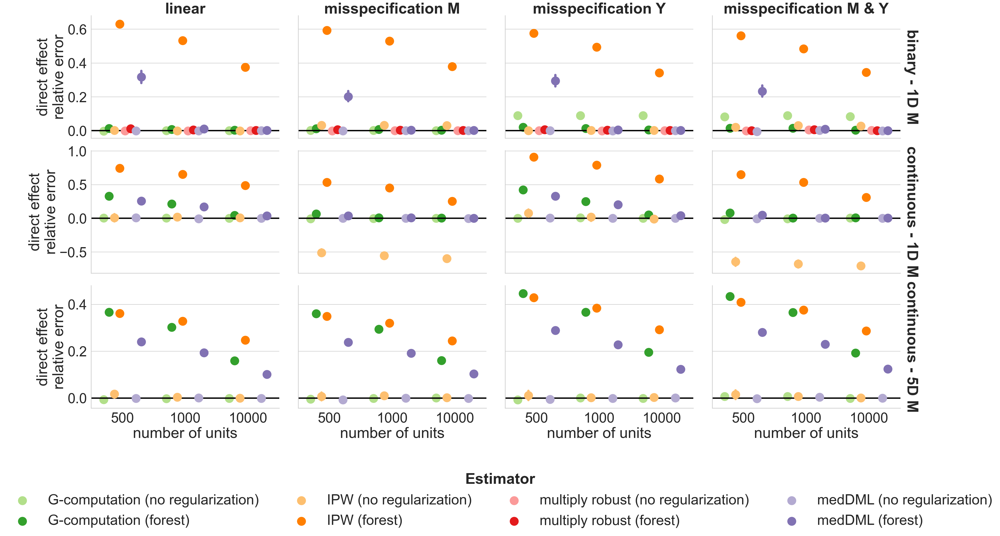

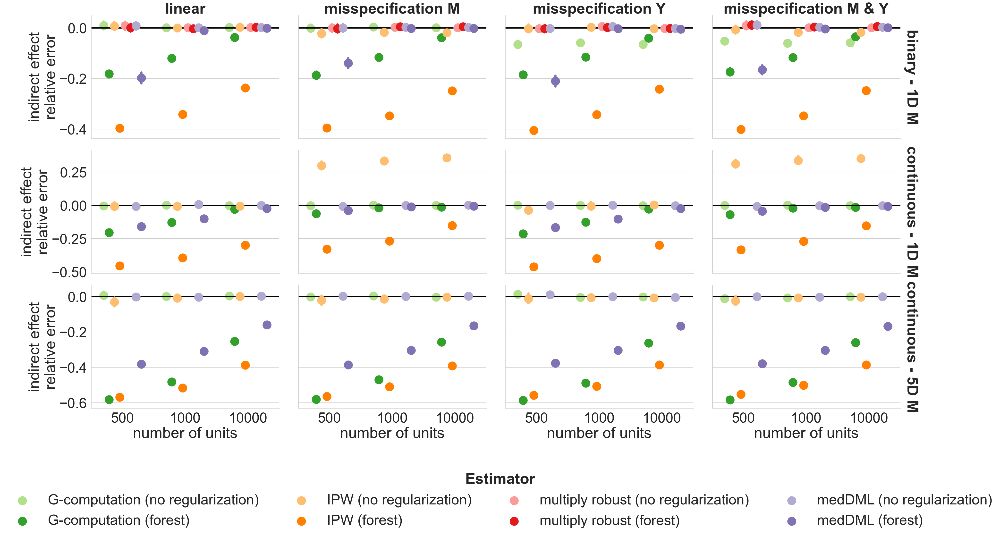

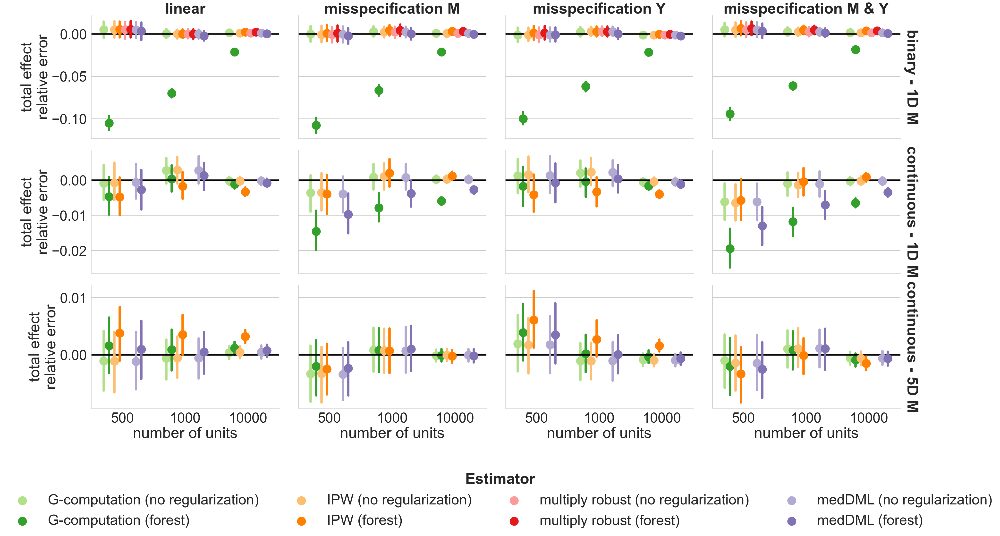

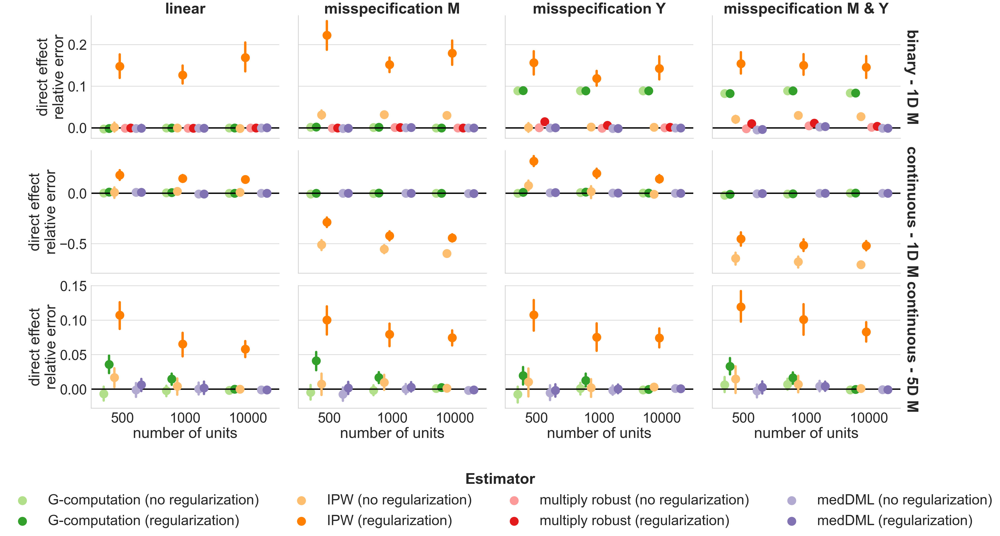

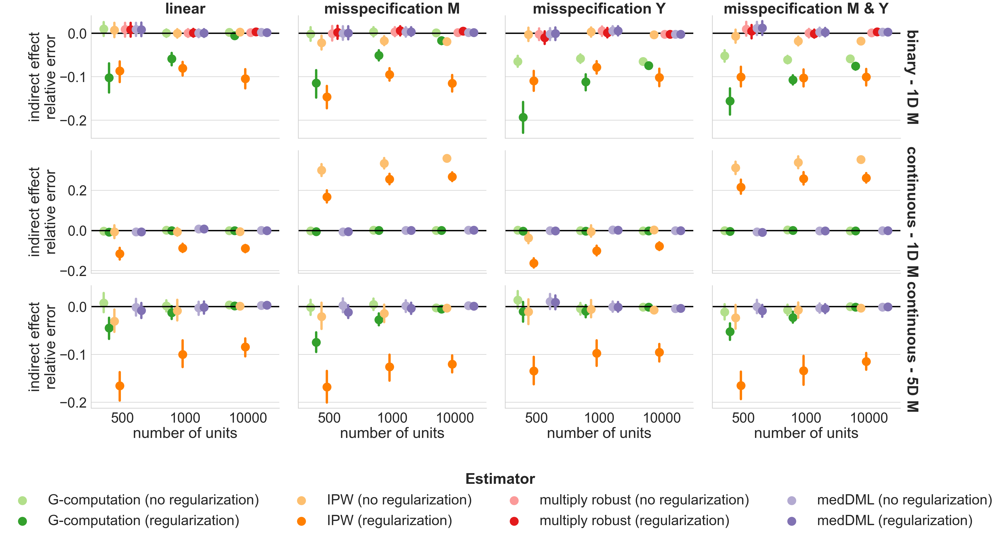

...

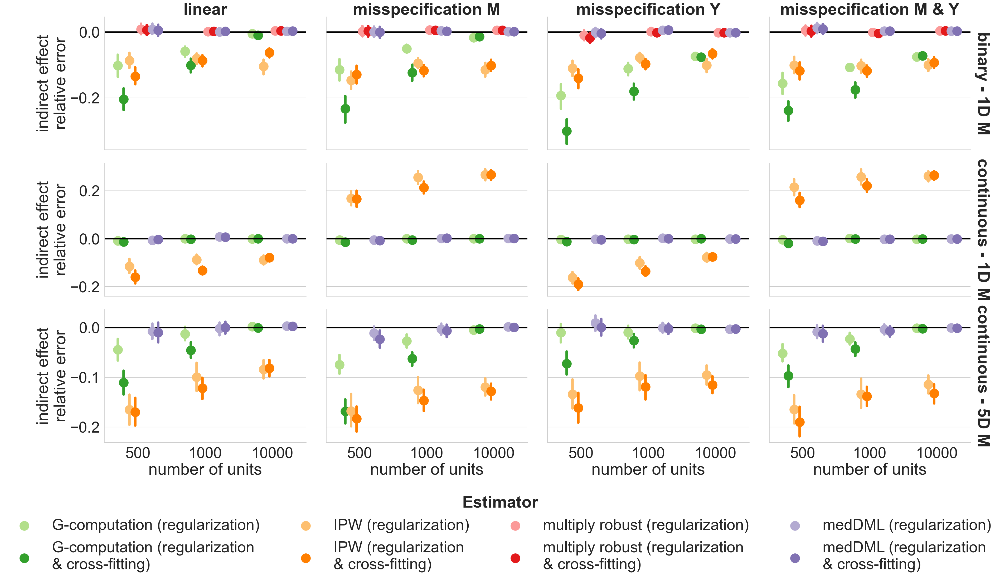

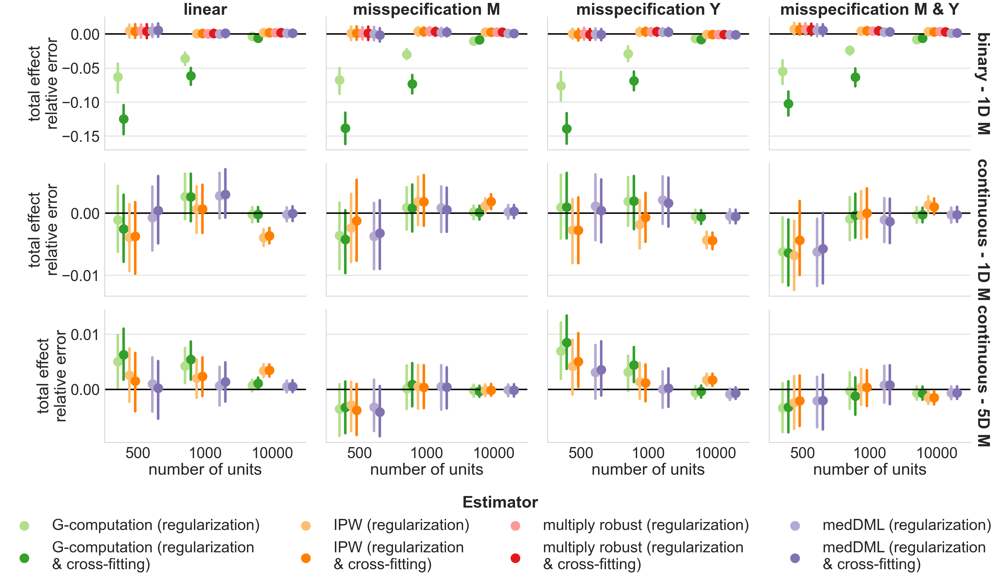

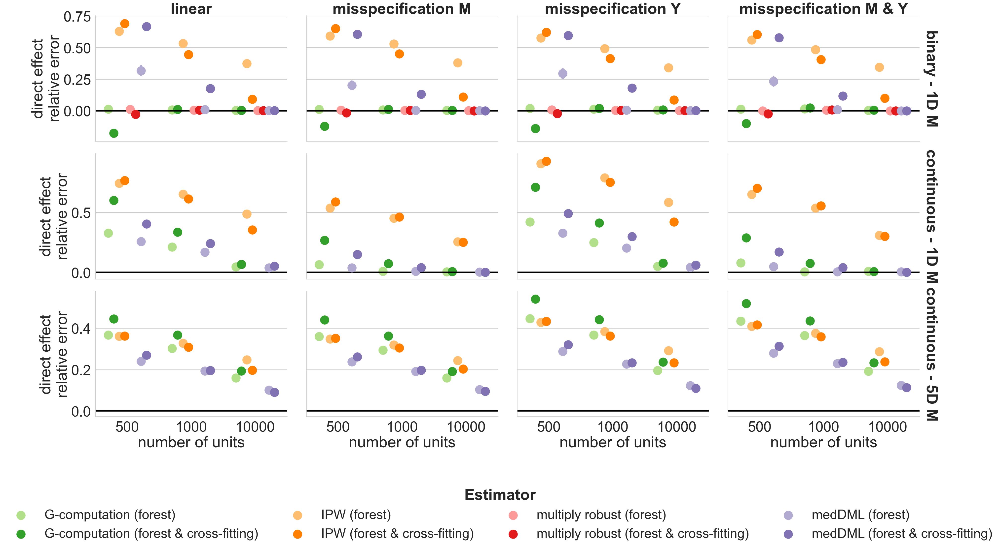

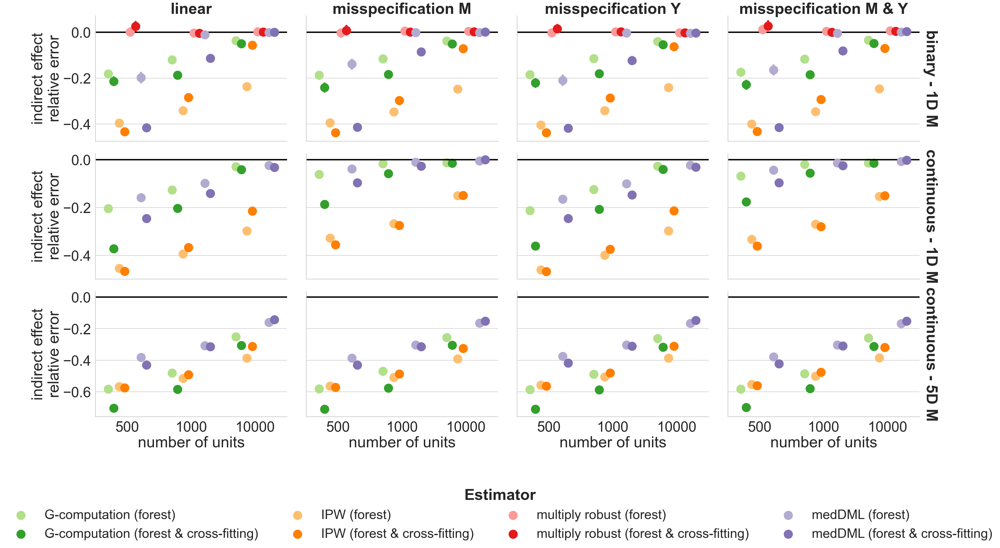

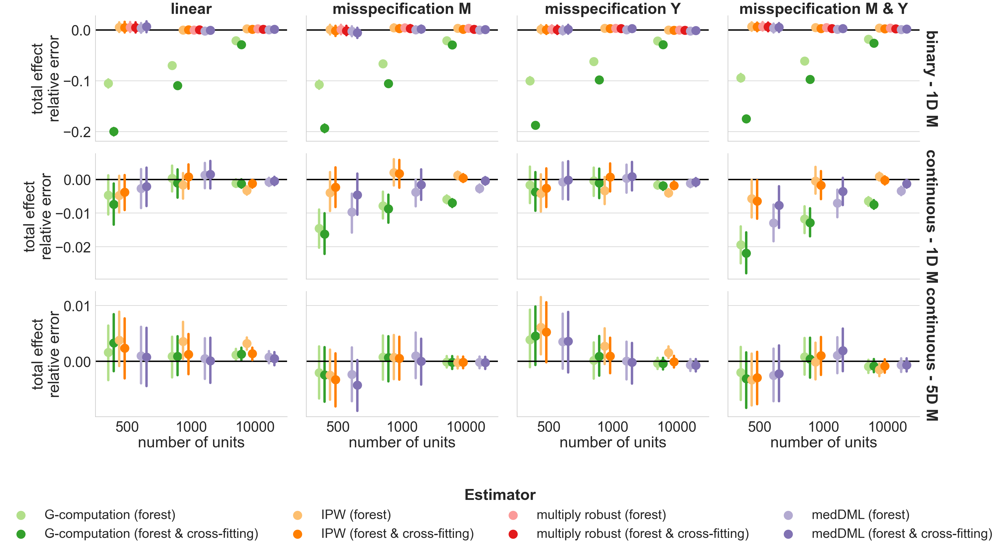

In [99]:
import warnings

warnings.filterwarnings('ignore')


conf = 'prop_high_no_overlap_violation'
for title, estimator_list in plot_dict.items():
    for effect in ['direct', 'indirect', 'total']:
        nice_estimator_list = [e for e in estimator_list]
        g = sns.catplot(x="n", y="{}_effect_error".format(effect), hue="nice_estimator",
                col="setting_name", row='configuration',
                data=res_df[(res_df.med_setting==conf)&(res_df.nice_estimator.isin(estimator_list))],
                aspect=1.5, height=7,
                kind='point', sharey='row', margin_titles=True, dodge=0.6,
                capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
                facet_kws={"gridspec_kws": {"hspace":0.1}},
                palette=sns.set_palette(palette=custom_paired_palette),
                hue_order=nice_estimator_list)
        for i in range(g.axes.shape[0]):
            for j in range(g.axes.shape[1]):
                true_val = 0
                g.axes[i, j].axhline(y=true_val, color="black", lw=4)
        [plt.setp(ax.texts, text="") for ax in g.axes.flat]
        for ax in g.axes.ravel():
            ax.set_xlabel(ax.get_xlabel().replace('n', 'number of units'))
            ax.set_ylabel(ax.get_ylabel().replace("{}_effect_error".format(effect), 
                                                 '{} effect\nrelative error'.format(effect)))
            #ax.get_xaxis().set_visible(False)
        

        ncol=4
        x_anchor = 0.05
        y_anchor = -0.15

        plt.subplots_adjust(hspace=0.1, wspace=0.1)
        g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')

        hh = plt.setp(g._legend.get_texts(), fontsize=55)

        fontsize = 42
        if title == "forest_cf_vs_nocf":
            fontsize=38
        sns.move_legend(g, "lower left", bbox_to_anchor=(x_anchor, y_anchor), ncol=ncol,
                        frameon=False, title="Estimator",
                        title_fontproperties={'weight':'bold'},
                        bbox_transform=g.fig.transFigure, fontsize=fontsize)
        for t in g._legend.texts:
            t.set_text(t.get_text().replace('n &', 'n\n&'))
    
        
        g._legend.set_in_layout(in_layout=True)

        plt.savefig('{}/{}_{}_effect.pdf'.format(output_path, title, effect),
                    bbox_extra_artists=(g._legend, ), bbox_inches='tight')

In [93]:
t.set_label('bla')

In [94]:
t.get_text()

'medDML (forest & cross-fitting)'

In [95]:
summary_plot_dict = {
    'linear_vs_forest': ['G-computation (no regularization)',
                          'G-computation (forest)',
                          'IPW (no regularization)',
                          'IPW (forest)',
                          'multiply robust (no regularization)',
                          'multiply robust (forest)',
                          'medDML (no regularization)',
                          'medDML (forest)'],
    'linear_reg_vs_noreg': ['G-computation (no regularization)',
                          'G-computation (regularization)',
                          'IPW (no regularization)',
                          'IPW (regularization)',
                          'multiply robust (no regularization)',
                          'multiply robust (regularization)',
                          'medDML (no regularization)',
                          'medDML (regularization)'],
    'linear_reg_cf_vs_nocf': ['G-computation (regularization)',
                          'G-computation (regularization & cross-fitting)',
                          'IPW (regularization)',
                          'IPW (regularization & cross-fitting)',
                          'multiply robust (regularization)',
                          'multiply robust (regularization & cross-fitting)',
                          'medDML (regularization)',
                          'medDML (regularization & cross-fitting)'],
    'forest_cf_vs_nocf': ['G-computation (forest)',
                          'G-computation (forest & cross-fitting)',
                          'IPW (forest)',
                          'IPW (forest & cross-fitting)',
                          'multiply robust (forest)',
                          'multiply robust (forest & cross-fitting)',
                          'medDML (forest)',
                          'medDML (forest & cross-fitting)']
}

custom_paired_palette = ["#b2df8a", "#33a02c", "#fdbf6f", "#ff7f00", "#fb9a99", "#e31a1c", '#b3aad1', '#8172b3']

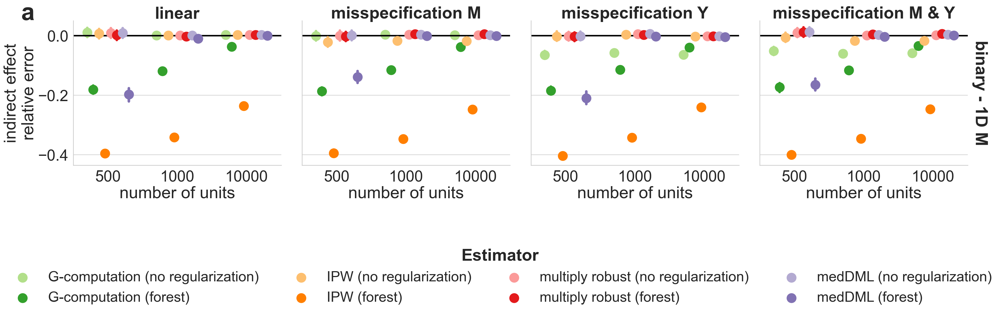

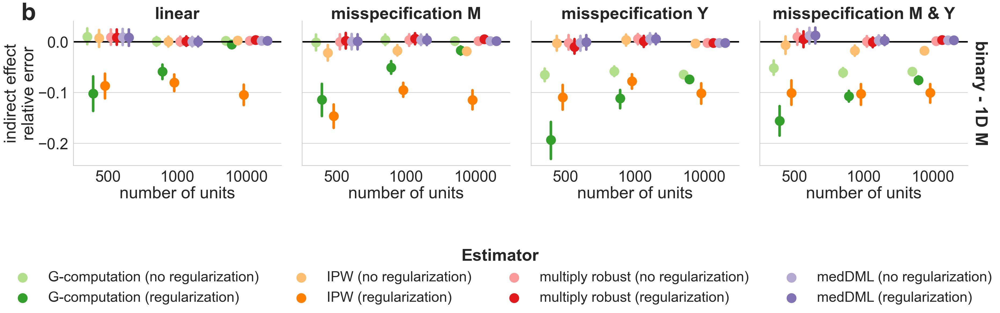

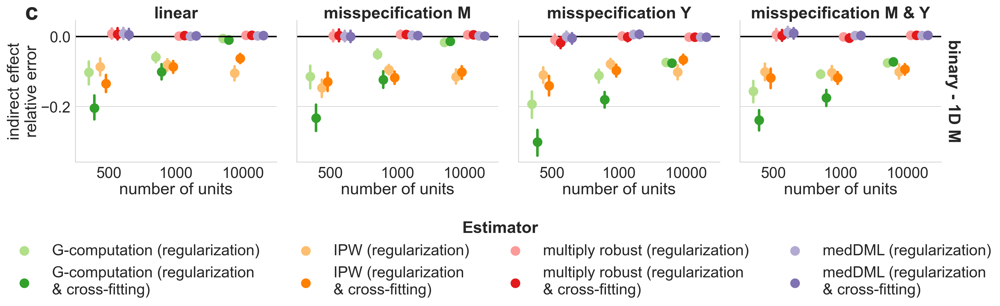

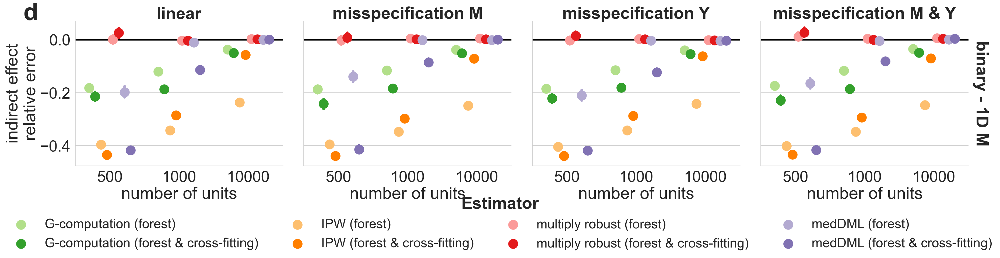

In [96]:
import warnings

warnings.filterwarnings('ignore')

effect = 'indirect'
conf = 'prop_high_no_overlap_violation'
letters = 'abcd'
letter_idx = 0
for title, estimator_list in summary_plot_dict.items():
    letter_lab = letters[letter_idx]
    nice_estimator_list = [e for e in estimator_list]
    g = sns.catplot(x="n", y="{}_effect_error".format(effect), hue="nice_estimator",
            col="setting_name",row='configuration',
            data=res_df[(res_df.med_setting==conf)&(res_df.nice_estimator.isin(estimator_list))&(res_df.configuration=='binary - 1D M')],
            aspect=1.5, height=7,
            kind='point', sharey='row', margin_titles=True, dodge=0.6,
            capsize=0, join=False, col_order=setting_order, scale=2, errwidth=7,
            facet_kws={"gridspec_kws": {"hspace":0.1}},
            palette=sns.set_palette(palette=custom_paired_palette),
            hue_order=nice_estimator_list)
    for i in range(g.axes.shape[0]):
        for j in range(g.axes.shape[1]):
            true_val = 0
            g.axes[i, j].axhline(y=true_val, color="black", lw=4)
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    for ax in g.axes.ravel():
        ax.set_xlabel(ax.get_xlabel().replace('n', 'number of units'))
        ax.set_ylabel(ax.get_ylabel().replace("{}_effect_error".format(effect), 
                                             '{} effect\nrelative error'.format(effect)))
        #ax.get_xaxis().set_visible(False)


    ncol=4
    x_anchor = 0.07
    y_anchor = -0.7 

    plt.subplots_adjust(hspace=0.1, wspace=0.1)
    g = g.set_titles(row_template='{row_name}', col_template='{col_name}', weight='bold')
    
    hh = plt.setp(g._legend.get_texts(), fontsize=45)

    fontsize = 38
    if title == "forest_cf_vs_nocf":
        fontsize=35
        y_anchor=-0.4
    elif title == 'linear_reg_cf_vs_nocf':
        fontsize=42
    sns.move_legend(g, "lower left", bbox_to_anchor=(x_anchor, y_anchor), ncol=ncol,
                    frameon=False, title="Estimator",
                    title_fontproperties={'weight':'bold'},
                    bbox_transform=g.fig.transFigure, fontsize=fontsize)
    for t in g._legend.texts:
            t.set_text(t.get_text().replace('n &', 'n\n&'))#.replace('n & c', 'n\n& c'))


    g._legend.set_in_layout(in_layout=True)
    ax = g.axes[0, 0]
    ax.text(-1.25, ax.get_ylim()[1]*1.05, letter_lab, weight='bold', fontsize=65)

    plt.savefig('{}/{}_summary_{}_{}_effect.pdf'.format(output_path, letter_lab, title, effect),
                bbox_extra_artists=(g._legend, ), bbox_inches='tight')
    letter_idx += 1

In [33]:
output_path

'../results/simulations/2025_figures'

In [34]:
sorted(res_df.nice_estimator.unique())

['Coefficient product',
 'G-computation (forest & cross-fitting)',
 'G-computation (forest)',
 'G-computation (no regularization)',
 'G-computation (regularization & cross-fitting)',
 'G-computation (regularization)',
 'IPW (forest & cross-fitting)',
 'IPW (forest)',
 'IPW (no regularization)',
 'IPW (regularization & cross-fitting)',
 'IPW (regularization)',
 'medDML (forest & cross-fitting)',
 'medDML (forest)',
 'medDML (no regularization)',
 'medDML (regularization & cross-fitting)',
 'medDML (regularization)',
 'multiply robust (forest & cross-fitting)',
 'multiply robust (forest)',
 'multiply robust (no regularization)',
 'multiply robust (regularization & cross-fitting)',
 'multiply robust (regularization)']

In [35]:
res_df.head()

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting
0,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,coefficient_product,1.523545,1.470279,1.470279,0.053266,0.053266,0.104086,1.420253,1.606637,1.386472,1.550347,1.386472,1.550347,0.003102,0.096086,0.003102,0.096086,True,0.186384,True,0.163875,True,0.163875,True,0.092984,True,0.092984,1.741176e+09,prop_low_no_overlap_violation,Coefficient product,False,False,False,Coefficient product,-0.006168,0.013405,-0.351764,binary - 1D M,misspecification M & Y,-0.028905,low MP
1,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_noreg,1.518898,1.487598,1.444149,0.074749,0.031300,0.076701,1.416778,1.602655,1.401856,1.563469,1.355329,1.532069,0.004115,0.129807,0.001398,0.068193,True,0.185877,True,0.161613,True,0.176740,True,0.125692,True,0.066795,1.741176e+09,prop_low_no_overlap_violation,IPW (no regularization),False,False,False,IPW,-0.009199,-0.004605,-0.090319,binary - 1D M,misspecification M & Y,-0.007422,low MP
2,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg,1.545092,1.489956,1.441118,0.103975,0.055137,0.231434,1.426136,1.607725,1.410763,1.582901,1.376152,1.561818,-0.024622,0.135509,-0.012911,0.071225,True,0.181589,True,0.172138,True,0.185666,True,0.160131,True,0.084136,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization),False,False,True,IPW,0.007887,-0.006694,0.265348,binary - 1D M,misspecification M & Y,0.021804,low MP
3,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_forest,1.526911,1.522203,1.496089,0.030822,0.004708,0.522162,1.426685,1.592737,1.432337,1.597024,1.420143,1.571583,-0.004881,0.058802,-0.012702,0.022168,True,0.166052,True,0.164687,True,0.151441,False,0.063683,False,0.034870,1.741176e+09,prop_low_no_overlap_violation,IPW (forest),True,False,False,IPW,-0.003972,0.031195,-0.624902,binary - 1D M,misspecification M & Y,-0.051349,low MP
4,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg_cf,1.527076,1.517817,1.499933,0.027143,0.009259,0.476440,1.423605,1.610887,1.421778,1.580106,1.383297,1.569722,-0.031510,0.124352,-0.026873,0.059338,True,0.187282,True,0.158328,True,0.186425,True,0.155863,True,0.086211,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization & cross-fitting),False,True,True,IPW,-0.003865,0.033845,-0.669679,binary - 1D M,misspecification M & Y,-0.055028,low MP


In [36]:
res_df[(res_df.type_m=='continuous')&(res_df.nice_estimator.str.contains('computation'))].head(50)

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting
115,0,500,5,1,continuous,0.5,0.5,True,True,0.243376,1.591530,1.462416,1.204189,0.387341,0.129114,mediation_g_computation_imp_noreg,1.629570,1.378567,1.109595,0.519976,0.251004,0.084945,1.513601,1.725604,1.253152,1.574241,1.043776,1.371110,0.270401,0.578088,0.105594,0.320125,True,0.212003,True,0.321088,True,0.327334,True,0.307687,True,0.214532,1.741176e+09,prop_low_no_overlap_violation,G-computation (no regularization),False,False,False,G-computation,0.023902,-0.078554,0.342424,continuous - 1D M,misspecification M & Y,0.132635,low MP
116,0,500,5,1,continuous,0.5,0.5,True,True,0.243376,1.591530,1.462416,1.204189,0.387341,0.129114,mediation_g_computation_imp_reg,1.632808,1.549719,1.184614,0.448194,0.083089,0.525794,1.518656,1.728407,1.277436,1.682330,1.052797,1.407409,0.239936,0.569812,0.002033,0.294131,True,0.209751,True,0.404895,True,0.354613,True,0.329876,True,0.292098,1.741176e+09,prop_low_no_overlap_violation,G-computation (regularization),False,False,True,G-computation,0.025936,-0.016256,0.157107,continuous - 1D M,misspecification M & Y,0.060854,low MP
117,0,500,5,1,continuous,0.5,0.5,True,True,0.243376,1.591530,1.462416,1.204189,0.387341,0.129114,mediation_g_computation_imp_forest,1.615313,1.495643,1.175379,0.439934,0.119670,1.079734,1.508088,1.721138,1.365617,1.656532,1.055319,1.321453,0.296819,0.566466,0.007883,0.203063,True,0.213050,True,0.290915,True,0.266134,True,0.269647,True,0.195180,1.741176e+09,prop_low_no_overlap_violation,G-computation (forest),True,False,False,G-computation,0.014944,-0.023925,0.135781,continuous - 1D M,misspecification M & Y,0.052594,low MP
118,0,500,5,1,continuous,0.5,0.5,True,True,0.243376,1.591530,1.462416,1.204189,0.387341,0.129114,mediation_g_computation_imp_reg_cf,1.634361,1.572507,1.402721,0.231640,0.061854,1.045709,1.522599,1.733551,1.346605,1.703522,1.066089,1.437787,0.220747,0.583339,-0.023969,0.263084,True,0.210953,True,0.356916,True,0.371698,True,0.362592,True,0.287052,1.741176e+09,prop_low_no_overlap_violation,G-computation (regularization & cross-fitting),False,True,True,G-computation,0.026912,0.164867,-0.401972,continuous - 1D M,misspecification M & Y,-0.155700,low MP
119,0,500,5,1,continuous,0.5,0.5,True,True,0.243376,1.591530,1.462416,1.204189,0.387341,0.129114,mediation_g_computation_imp_forest_cf,1.595242,1.525249,1.284461,0.310782,0.069993,1.938464,1.502497,1.729764,1.416574,1.668565,1.121020,1.361167,0.232898,0.511367,-0.016097,0.140704,True,0.227267,True,0.251991,True,0.240147,True,0.278469,True,0.156802,1.741176e+09,prop_low_no_overlap_violation,G-computation (forest & cross-fitting),True,True,False,G-computation,0.002333,0.066660,-0.197652,continuous - 1D M,misspecification M & Y,-0.076559,low MP
141,0,500,5,1,continuous,0.5,0.5,False,True,0.237827,1.576779,1.451779,1.201779,0.375000,0.125000,mediation_g_computation_imp_noreg,1.610774,1.460248,1.256227,0.354547,0.150526,0.084907,1.500975,1.726924,1.293783,1.580039

In [37]:
res_df.head()

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_contains_true,total_effect_interval_width,direct_treated_effect_contains_true,direct_treated_effect_interval_width,direct_control_effect_contains_true,direct_control_effect_interval_width,indirect_treated_effect_contains_true,indirect_treated_effect_interval_width,indirect_control_effect_contains_true,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting
0,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,coefficient_product,1.523545,1.470279,1.470279,0.053266,0.053266,0.104086,1.420253,1.606637,1.386472,1.550347,1.386472,1.550347,0.003102,0.096086,0.003102,0.096086,True,0.186384,True,0.163875,True,0.163875,True,0.092984,True,0.092984,1.741176e+09,prop_low_no_overlap_violation,Coefficient product,False,False,False,Coefficient product,-0.006168,0.013405,-0.351764,binary - 1D M,misspecification M & Y,-0.028905,low MP
1,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_noreg,1.518898,1.487598,1.444149,0.074749,0.031300,0.076701,1.416778,1.602655,1.401856,1.563469,1.355329,1.532069,0.004115,0.129807,0.001398,0.068193,True,0.185877,True,0.161613,True,0.176740,True,0.125692,True,0.066795,1.741176e+09,prop_low_no_overlap_violation,IPW (no regularization),False,False,False,IPW,-0.009199,-0.004605,-0.090319,binary - 1D M,misspecification M & Y,-0.007422,low MP
2,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg,1.545092,1.489956,1.441118,0.103975,0.055137,0.231434,1.426136,1.607725,1.410763,1.582901,1.376152,1.561818,-0.024622,0.135509,-0.012911,0.071225,True,0.181589,True,0.172138,True,0.185666,True,0.160131,True,0.084136,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization),False,False,True,IPW,0.007887,-0.006694,0.265348,binary - 1D M,misspecification M & Y,0.021804,low MP
3,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_forest,1.526911,1.522203,1.496089,0.030822,0.004708,0.522162,1.426685,1.592737,1.432337,1.597024,1.420143,1.571583,-0.004881,0.058802,-0.012702,0.022168,True,0.166052,True,0.164687,True,0.151441,False,0.063683,False,0.034870,1.741176e+09,prop_low_no_overlap_violation,IPW (forest),True,False,False,IPW,-0.003972,0.031195,-0.624902,binary - 1D M,misspecification M & Y,-0.051349,low MP
4,0,500,5,1,binary,0.5,0.5,True,True,0.053601,1.533001,1.505611,1.45083,0.082171,0.02739,mediation_ipw_reg_cf,1.527076,1.517817,1.499933,0.027143,0.009259,0.476440,1.423605,1.610887,1.421778,1.580106,1.383297,1.569722,-0.031510,0.124352,-0.026873,0.059338,True,0.187282,True,0.158328,True,0.186425,True,0.155863,True,0.086211,1.741176e+09,prop_low_no_overlap_violation,IPW (regularization & cross-fitting),False,True,True,IPW,-0.003865,0.033845,-0.669679,binary - 1D M,misspecification M & Y,-0.055028,low MP


In [38]:
#res_df = res_df.assign(total_effect_error=(res_df.total_effect-res_df.total)/res_df.total,
#                       direct_effect_error=(res_df.direct_control_effect-res_df.direct_0)/res_df.direct_0,
#                       indirect_effect_error=(res_df.indirect_treated_effect-res_df.indirect_1)/res_df.indirect_1)

In [39]:
res_df_melt_coverage = pd.melt(res_df,
                      id_vars=[c for c in res_df.columns if 'contains_true' not in c],
                     value_vars=[c for c in res_df.columns if 'contains_true' in c],
                     value_name='coverage')
res_df_melt_coverage = res_df_melt_coverage.assign(coverage_name=res_df_melt_coverage.variable.str.replace('_effect_contains_true', ''))
res_df_melt_coverage = res_df_melt_coverage[res_df_melt_coverage.coverage_name.isin(['total', 'direct_control', 'indirect_treated'])]
res_df_melt_coverage = res_df_melt_coverage.assign(coverage_name=res_df_melt_coverage.coverage_name.str.split('_').str.get(0))
res_df_melt_coverage.sample(5)

,rep_id,n,dim_x,dim_m,type_m,wt_list,wm_list,m_misspec,y_misspec,mediated_prop,total,direct_1,direct_0,indirect_1,indirect_0,estimator,total_effect,direct_treated_effect,direct_control_effect,indirect_treated_effect,indirect_control_effect,duration,total_effect_2.5,total_effect_97.5,direct_treated_effect_2.5,direct_treated_effect_97.5,direct_control_effect_2.5,direct_control_effect_97.5,indirect_treated_effect_2.5,indirect_treated_effect_97.5,indirect_control_effect_2.5,indirect_control_effect_97.5,total_effect_interval_width,direct_treated_effect_interval_width,direct_control_effect_interval_width,indirect_treated_effect_interval_width,indirect_control_effect_interval_width,timestamp,med_setting,nice_estimator,forest,cross_fitting,regularization,base_estimator,total_effect_error,direct_effect_error,indirect_effect_error,configuration,setting_name,abs_indirect_effect_error,nice_med_setting,variable,coverage,coverage_name
1086047,169,500,5,5,continuous,0.3,5.0,True,False,0.384244,1.948823,1.200000,1.200000,0.748823,0.748823,mediation_ipw_forest,1.939361,1.611409,1.627831,0.311530,0.327952,0.555444,1.836360,2.041172,1.514243,1.753036,1.547569,1.749683,0.200973,0.372655,0.213494,0.380802,0.204812,0.238793,0.202114,0.171682,0.167308,1.741863e+09,prop_high_no_overlap_violation,IPW (forest),True,False,False,IPW,-0.004855,0.356526,-0.583973,continuous - 5D M,misspecification M,-0.437293,high MP\nNo OV,direct_control_effect_contains_true,False,direct
913890,78,10000,5,5,continuous,1.0,1.0,False,True,0.455263,2.196535,1.696535,1.196535,1.000000,0.500000,mediation_g_computation_imp_noreg,2.201691,1.645287,1.244924,0.956767,0.556404,0.101040,2.184616,2.223050,1.596995,1.765017,1.153062,1.321985,0.882847,1.052878,0.433713,0.607871,0.038434,0.168021,0.168923,0.170031,0.174158,1.741179e+09,prop_high_strong_overlap_violation,G-computation (no regularization),False,False,False,G-computation,0.002348,0.040442,-0.043233,continuous - 5D M,misspecification Y,-0.043233,high MP\nWith OV,direct_control_effect_contains_true,True,direct
872509,57,500,5,1,continuous,2.0,1.0,True,False,0.452892,2.193350,1.200000,1.200000,0.993350,0.993350,mediation_DML_reg_cf,2.227695,1.444326,1.133780,1.093914,0.783369,1.659732,2.094433,2.317060,NaN,NaN,1.036820,1.793061,0.463469,1.198770,NaN,NaN,0.222627,NaN,0.756242,0.735301,NaN,1.741178e+09,prop_high_strong_overlap_violation,medDML (regularization & cross-fitting),False,True,True,medDML,0.015658,-0.055183,0.101237,continuous - 1D M,misspecification M,0.100564,high MP\nWith OV,direct_control_effect_contains_true,True,direct
1241505,50,10000,5,1,binary,0.5,0.5,False,True,0.057561,1.539128,1.509597,1.450534,0.088595,0.029532,mediation_multiply_robust_reg,1.527148,1.503500,1.456243,0.070905,0.023648,0.941871,1.506843,1.564516,1.480084,1.525934,1.433184,1.480588,0.057647,0.101604,0.019764,0.056673,0.057672,0.045850,0.047404,0.043956,0.036909,1.741178e+09,prop_low_no_overlap_violation,multiply robust (regularization),False,False,True,multiply robust,-0.007784,0.003936,-0.199671,binary - 1D M,misspecification Y,-0.017690,low MP,indirect_treated_effect_contains_true,True,indirect
896170,69,10000,5,1,binary,0.5,0.5,True,False,0.022279,1.227343,1.200000,1.200000,0.027343,0.027343,mediation_ipw_reg_cf,1.239929,1.216938,1.214251,0.025679,0.022992,0.707513,1.223307,1.278249,1.194363,1.246642,1.190209,1.246092,0.007950,0.050497,0.008964,0.047620,0.054942,0.052280,0.055882,0.042546,0.038656,1.741179e+09,prop_low_no_overlap_violation,IPW (regularization & cross-fitting),False,True,True,IPW,0.010255,0.011876,-0.060881,binary - 1D M,misspecification M,-0.001665,low MP,direct_control_effect_contains_true,True,direct


In [40]:
res_df_melt_coverage.coverage_name.value_counts()

total       381600
direct      381600
indirect    381600
Name: coverage_name, dtype: int64

In [41]:
var_df = pd.read_csv('../results/20240421_smri_dmri_pca.csv')
var_df.index = var_df.index + 1
var_df

,Unnamed: 0,percentage of variance
1,d1,0.192882
2,d2,0.092418
3,d3,0.052382
4,d4,0.039436
5,d5,0.031261
6,d6,0.030776
7,d7,0.021972
8,d8,0.017008
9,d9,0.016509
10,d10,0.013868


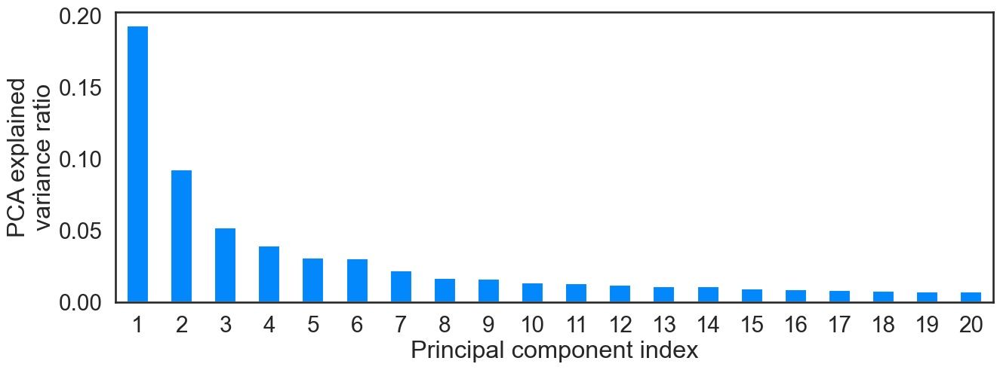

In [42]:
sns.set_context('talk', font_scale=1.3)
sns.set_style('white')
fig, ax = plt.subplots(figsize=(15, 5))
var_df[['percentage of variance']].plot.bar(rot=0, ax=ax, legend=False, color='#0388fc')
ax.set_ylabel('PCA explained\nvariance ratio')
ax.set_xlabel('Principal component index')
plt.savefig('../results/20240421_ukbb_pca_var_smri_dmri.pdf', bbox_inches='tight')